<h1 style="padding-top: 25px;padding-bottom: 25px;text-align: left; padding-left: 10px; background-color: #DDDDDD; 
    color: black;"> <img style="float: left; padding-right: 10px; width: 45px" src="https://raw.githubusercontent.com/Harvard-IACS/2018-CS109A/master/content/styles/iacs.png"> CS209A Introduction to Data Science </h1>

## Prediction on US Stock Market Performance: S&P 500

**Harvard University**<br/>
**Fall 2022**<br/>
**Team12**: Danning (Danni) Lai, Sijia (Nancy) Li, Xu (Victoria) Tang, and Hanlin (Lily) Zhu



<hr style='height:2px'>

In [ ]:
# RUN THIS CELL 
import requests
from IPython.core.display import HTML
styles = requests.get(
    "https://raw.githubusercontent.com/Harvard-IACS/2021-CS109A/master/"
    "themes/static/css/cs109.css"
).text
HTML(styles)

<a id="contents"></a>

## Notebook contents

- [**Problem Statement**](#Part1)


- [**Package Installation and Import Statements**](#part2)


- [**Data Collection**](#part3) 


- [**Overview and Data Description**](#part4) 


- [**Data Preprocessing and Train Test Split**](#part5) 


- [**Exploratory Data Analysis**](#part6) 


- [**Baseline Model 1: Historical Mean Method**](#part7) 

  
- [**Baseline Model 2: Naive Method**](#part8) 


- [**Baseline Model 3: Autoregressive Model**](#part9) 


- [**Model 1: Vector Autoregression**](#part10)


- [**Model 2: Multivariate Long Short Memory Model**](#part11)


- [**Model Comparison and Conclusion**](#part12)
  

<a id="intro"></a>

## Problem Statement

[Return to contents](#contents)

The problem of interest is to predict returns on S&P 500 index using indicators from three markets - energy, bullion, and bonds.


<a id="part2"></a>

## Package Installation and Import Statements

[Return to contents](#contents)

In [ ]:
!pip install yfinance

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 62 kB 705 kB/s 
  Attempting uninstall: requests
    Found existing installation: requests 2.23.0
    Uninstalling requests-2.23.0:
      Successfully uninstalled requests-2.23.0


In [ ]:
#data collection
import yfinance as yf #yahoo finance

#stats
import scipy.stats as scs
from scipy.stats import norm
from scipy.stats import pearsonr
import statsmodels.tsa.api as smt 
import statsmodels.formula.api as smf 
import statsmodels.api as sm
import statsmodels.stats as sms
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import acf
from statsmodels.tsa.vector_ar.vecm import coint_johansen
from statsmodels.tsa.stattools import grangercausalitytests
from statsmodels.tsa.ar_model import AutoReg, ar_select_order
from statsmodels.stats.diagnostic import acorr_ljungbox
from statsmodels.stats.stattools import durbin_watson

#Data management
import pandas as pd
import numpy as np

#visualization
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt 
from matplotlib import cycler

#machine learning
from tqdm import trange
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.metrics import mean_squared_error
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM
from tensorflow.keras.layers import Dense, Dropout, Activation
from keras.callbacks import EarlyStopping
from tensorflow.keras.callbacks import CSVLogger, EarlyStopping
from sklearn.model_selection import train_test_split
from keras.regularizers import l1,l2,L1L2


#metrics
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error as mse 
from sklearn.metrics import mean_absolute_percentage_error as mape 

sns.set(style='darkgrid')
plt.rcParams['font.family']='serif'
plt.rcParams['font.serif']=['Times New Roman']+plt.rcParams['font.serif']
plt.rcParams['figure.figsize']=[16,9]
colors = cycler('color',['#4682B4','#ffc20e','#FF6347','#9932CC','#00ae9d','#2a5caa','#9d9087'])
plt.rc('axes', prop_cycle=colors)
pd.set_option('display.max_columns',20)
pd.set_option('display.max_rows',100)

%matplotlib inline
%config InlineBackend.figure_format = 'retina'


<a id="part3"></a>

## Data Collection

[Return to contents](#contents)


To predict the US stock market performance (S&P 500), five types of data are collected: S&P 500 historical prices, US 13-week treasury bill yield, US 10-year treasury yield, crude oil futures prices, and gold futures prices. The data collected are daily time series data from November 1, 2002 to October 31, 2022 (20 years). All data are obtained from the adjusted closing prices column on Yahoo Finance. 


In [ ]:
ASSET_TICKERS=['^GSPC','^TNX','^IRX','CL=F','GC=F']
START_DATE='2002-11-01'
END_DATE='2022-11-01'

In [ ]:
retrieved_data=yf.download(ASSET_TICKERS,
                    start=START_DATE,
                    end=END_DATE,
                    ajusted=True,
                    progress=False)

raw_data = retrieved_data.copy()[['Adj Close']]
raw_data.rename(columns={'^GSPC':'S&P 500 Index','^IRX':'3 Month T-Bill Yield','^TNX':'10 Year Treasury Yield','GC=F':'Gold Futures Price','CL=F':'Crude Oil Futures Price'},inplace=True)
raw_data.columns = raw_data.columns.droplevel()
raw_data.index = pd.to_datetime(raw_data.index).date

<a id="part4"></a>

## Overview and Data Description

[Return to contents](#contents)

In [ ]:
'''Preview'''

raw_data.head()

,Crude Oil Futures Price,Gold Futures Price,S&P 500 Index,3 Month T-Bill Yield,10 Year Treasury Yield
2002-11-01,27.129999,318.799988,900.960022,1.397,3.977
2002-11-04,26.950001,318.299988,908.349976,1.407,4.045
2002-11-05,26.139999,318.200012,915.390015,1.395,4.081
2002-11-06,25.770000,317.500000,923.760010,1.207,4.035
2002-11-07,25.379999,320.500000,902.650024,1.195,3.882


In [ ]:
'''Basic Statistics'''

raw_data.describe()

,Crude Oil Futures Price,Gold Futures Price,S&P 500 Index,3 Month T-Bill Yield,10 Year Treasury Yield
count,5027.000000,5022.000000,5034.000000,5027.000000,5027.000000
mean,67.436109,1149.920908,1948.743744,1.170003,2.905245
std,24.098957,463.761173,982.990522,1.458413,1.128670
min,-37.630001,316.799988,676.530029,-0.105000,0.499000
25%,48.764999,750.699997,1205.774963,0.068000,2.001000
50%,63.720001,1233.850037,1512.034973,0.350000,2.750000
75%,87.440002,1492.974976,2528.565063,1.863000,3.911000
max,145.289993,2051.500000,4796.560059,5.045000,5.248000


In [ ]:
'''Check Missingness'''

raw_data.isnull().sum(axis=0)

Crude Oil Futures Price    11
Gold Futures Price         16
S&P 500 Index               4
3 Month T-Bill Yield       11
10 Year Treasury Yield     11
dtype: int64

<a id="part5"></a>

## Data Preprocessing and Train Test Split

[Return to contents](#contents)

In [ ]:
'''resampling to weekly frequency and missing data imputation'''

dates=pd.DataFrame(index=pd.date_range(start=START_DATE,end=END_DATE,freq='D'))
df = dates.join(raw_data,how='left').fillna(method='ffill').asfreq('W')

In [ ]:
'''create new predictor'''

df['10Y-3M Treasury Yield Spread']=df['10 Year Treasury Yield']-df['3 Month T-Bill Yield']
df.drop('10 Year Treasury Yield',axis=1,inplace=True)

In [ ]:
'''preview'''

df.head()

,Crude Oil Futures Price,Gold Futures Price,S&P 500 Index,3 Month T-Bill Yield,10Y-3M Treasury Yield Spread
2002-11-03,27.129999,318.799988,900.960022,1.397,2.580
2002-11-10,25.780001,321.299988,894.739990,1.197,2.655
2002-11-17,25.510000,320.700012,909.830017,1.197,2.854
2002-11-24,26.760000,320.700012,930.549988,1.198,2.977
2002-12-01,26.889999,316.799988,936.309998,1.202,3.011


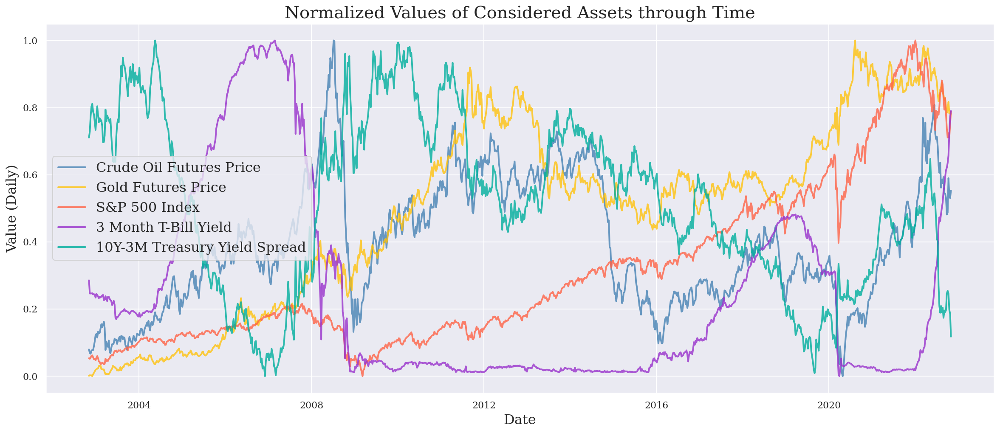

In [ ]:
'''visualization'''

scaler = MinMaxScaler(feature_range=(0, 1))
sdf_np = scaler.fit_transform(df)  
sdf = pd.DataFrame(sdf_np, columns=df.columns, index=df.index)

fig = plt.figure(figsize=(20,8))
ax=fig.gca()
ax.plot(sdf,lw=2,alpha=0.8)
ax.set_title('Normalized Values of Considered Assets through Time',fontsize=20)
ax.set_ylabel('Value (Daily)',fontsize=16)
ax.set_xlabel('Date',fontsize=16)
ax.legend(df.columns,fontsize=16)

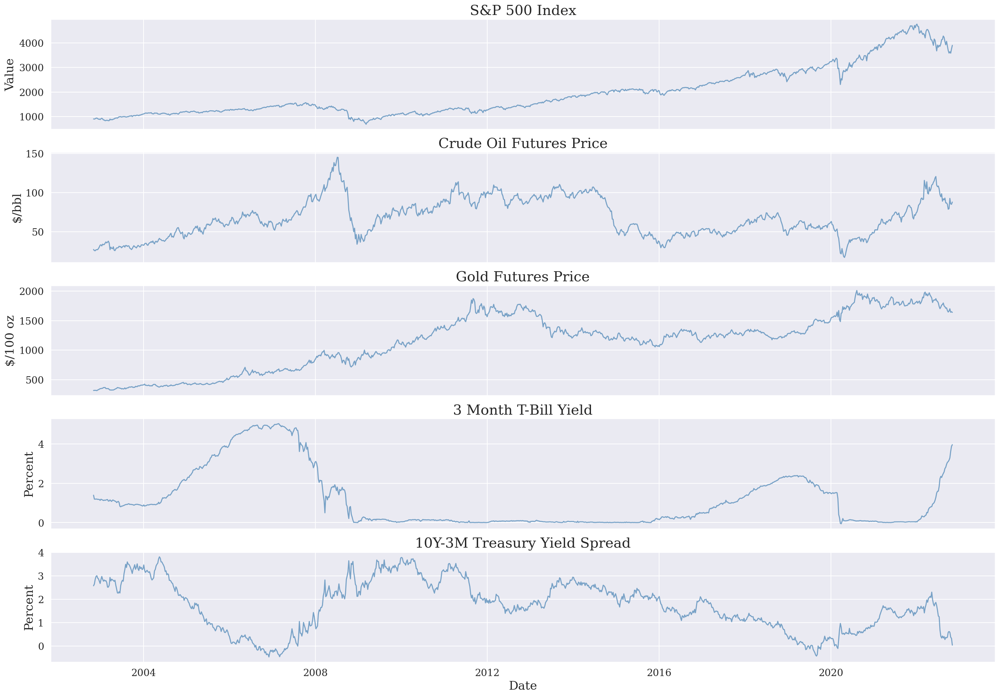

In [ ]:
'''Comparing the time series'''

fig,ax=plt.subplots(nrows=len(df.columns),ncols=1,sharex=True,figsize=[20,14])

ax[0].plot(df['S&P 500 Index'],alpha=0.7)
ax[0].tick_params(labelsize=14)
ax[0].set_ylabel('Value',fontsize=17)
ax[0].set_title('S&P 500 Index',fontsize=20)

ax[1].plot(df['Crude Oil Futures Price'],alpha=0.7)
ax[1].tick_params(labelsize=14)
ax[1].set_ylabel('$/bbl',fontsize=17)
ax[1].set_title('Crude Oil Futures Price',fontsize=20)

ax[2].plot(df['Gold Futures Price'],alpha=0.7)
ax[2].tick_params(labelsize=14)
ax[2].set_ylabel('$/100 oz',fontsize=17)
ax[2].set_title('Gold Futures Price',fontsize=20)

ax[3].plot(df['3 Month T-Bill Yield'],alpha=0.7)
ax[3].tick_params(labelsize=14)
ax[3].set_ylabel('Percent',fontsize=17)
ax[3].set_title('3 Month T-Bill Yield',fontsize=20)

ax[4].plot(df['10Y-3M Treasury Yield Spread'],alpha=0.7)
ax[4].tick_params(labelsize=14)
ax[4].set_ylabel('Percent',fontsize=17)
ax[4].set_title('10Y-3M Treasury Yield Spread',fontsize=20)
ax[4].set_xlabel('Date',fontsize=17)

plt.tight_layout()

In [ ]:
'''Differencing'''

df_rtn = df.copy()
df_rtn['S&P 500 Index']=np.log(df_rtn['S&P 500 Index']/df_rtn['S&P 500 Index'].shift(1))*100
df_rtn['Crude Oil Futures Price']=np.log(df_rtn['Crude Oil Futures Price']/df_rtn['Crude Oil Futures Price'].shift(1))*100
df_rtn['Gold Futures Price']=np.log(df_rtn['Gold Futures Price']/df_rtn['Gold Futures Price'].shift(1))*100
df_rtn['3 Month T-Bill Yield']=df_rtn['3 Month T-Bill Yield'].diff()
df_rtn['10Y-3M Treasury Yield Spread']=df_rtn['10Y-3M Treasury Yield Spread'].diff()
df_rtn = df_rtn.rename(columns={'Crude Oil Futures Price':'Crude Oil Futures Log Return', 
                        'Gold Futures Price':'Gold Futures Log Return',
                        'S&P 500 Index':'S&P 500 Log Return',
                        '3 Month T-Bill Yield':'Change in 3M T-Bill Yield',
                        '10Y-3M Treasury Yield Spread':'Change in 10Y-3M Treasury Yield Spread'})
df_rtn = df_rtn.dropna()

In [ ]:
'''Split to Estimation and Prediction (test) set'''
'''From this code block onward, all visualiations are on estimation_df'''

test_size = int(0.05 * len(df_rtn))

test_data = df_rtn.iloc[-test_size:,:]
estimation_data = df_rtn.iloc[:-test_size,:]

display(estimation_data.head())
display(test_data.head())


,Crude Oil Futures Log Return,Gold Futures Log Return,S&P 500 Log Return,Change in 3M T-Bill Yield,Change in 10Y-3M Treasury Yield Spread
2002-11-10,-5.104107,0.781132,-0.692772,-0.200,0.075
2002-11-17,-1.052848,-0.186908,1.672463,0.000,0.199
2002-11-24,4.783770,0.000000,2.251801,0.001,0.123
2002-12-01,0.484620,-1.223552,0.617082,0.004,0.034
2002-12-08,0.148647,2.954654,-2.605449,-0.019,-0.101


,Crude Oil Futures Log Return,Gold Futures Log Return,S&P 500 Log Return,Change in 3M T-Bill Yield,Change in 10Y-3M Treasury Yield Spread
2021-11-07,-2.790770,1.855919,1.981163,-0.008,-0.096
2021-11-14,-0.592370,2.795828,-0.312987,0.003,0.126
2021-11-21,-5.980496,-0.898077,0.322144,0.002,-0.048
2021-11-28,-11.033706,-3.624756,-2.224228,-0.002,-0.052
2021-12-05,-2.812475,-0.185017,-1.230490,0.000,-0.139


Text(0.5, 1.0, 'Train Test split on S&P 500 Log Return')

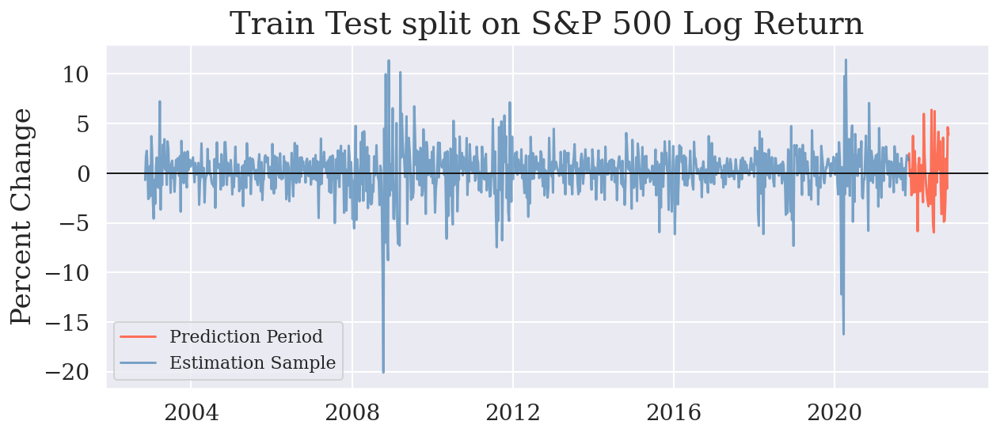

In [ ]:
'''visualizing the splits e.g. for S&P 500 '''

fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[10,4])
ax.plot(df_rtn.iloc[-test_size:,2],alpha=0.9,label="Prediction Period",color="tomato")
ax.plot(df_rtn.iloc[:-test_size,2],alpha=0.7,label="Estimation Sample",color="steelblue")
ax.axhline(0,color='k',lw=1)
ax.legend()
ax.tick_params(labelsize=14)
ax.set_ylabel('Percent Change',fontsize=17)
ax.set_title('Train Test split on S&P 500 Log Return',fontsize=20)

<a id="part6"></a>

## Exploratory Data Analysis

[Return to contents](#contents)

In [ ]:
'''Basic stats'''

estimation_data.describe()

,Crude Oil Futures Log Return,Gold Futures Log Return,S&P 500 Log Return,Change in 3M T-Bill Yield,Change in 10Y-3M Treasury Yield Spread
count,991.000000,991.000000,991.000000,991.000000,991.000000
mean,0.113526,0.173712,0.164634,-0.001361,-0.001081
std,5.415192,2.442749,2.404441,0.085104,0.130966
min,-34.686323,-10.131569,-20.083751,-0.815000,-0.712000
25%,-2.540889,-1.106701,-0.823095,-0.013000,-0.080000
50%,0.483443,0.347480,0.282574,0.001000,-0.013000
75%,3.085422,1.618136,1.404862,0.020000,0.065000
max,27.575629,12.391672,11.423675,0.850000,0.692000


In [ ]:
'''Stationarity test'''

def ADF_test( series, max_lag = None):
  result = ""
  output = {'test_statistic':round(adfuller(series,max_lag)[0],4), 'pvalue':round(adfuller(series,max_lag)[1],4)}
  result += f'\nAugmented Dickey-Fuller Test'
  result += f'\nTest Statistic = {output["test_statistic"]}'
  if output['pvalue']  <= 0.05:
      result+=(f"\nP-Value = {output['pvalue']}. \nWe reject the null hypothesis.")
      result+=(f"\n{series.name} series is stationary.")
  else:
      result+=(f"\nP-Value = {output['pvalue']}. \nWe fail to reject the null hypothesis.")
      result+=(f"\n{series.name} series is not stationary.")
  return result

In [ ]:
'''Time Series Analysis Plot'''

def tsplot(original_series, rtn_series, ts_unit, rtn_unit,lim, lags=52, figsize=(16, 16), style='bmh'):

  sns.set(font_scale=1)
  adf_result = ADF_test(rtn_series)
  original_series = original_series.iloc[:-test_size]

  y1 = original_series
  y2 = rtn_series

  if not isinstance(y1, pd.Series):
      y1 = pd.Series(y1)
  if not isinstance(y2, pd.Series):
      y2 = pd.Series(y2)
      
  with plt.style.context(style):    
      fig = plt.figure(figsize=figsize)
      layout = (4, 2)
      ts_ax = plt.subplot2grid(layout, (0, 0), colspan=2)
      rtn_ax = plt.subplot2grid(layout, (1, 0), colspan=2)
      acf_ax = plt.subplot2grid(layout, (2, 0))
      pacf_ax = plt.subplot2grid(layout, (2, 1))
      hist_ax = plt.subplot2grid(layout, (3, 0))
      qq_ax = plt.subplot2grid(layout, (3, 1))
      
      y1.plot(ax=ts_ax)
      ts_ax.set_title(f'{original_series.name} Time Series')
      ts_ax.set_ylabel(ts_unit,fontsize = 16)
      ts_ax.set_xlabel('Date',fontsize = 16)
      ts_ax.tick_params(labelsize=14)


      y2.plot(ax=rtn_ax)
      rtn_ax.set_title(f'{rtn_series.name} Time Series')
      rtn_ax.set_ylabel(rtn_unit,fontsize = 16)
      rtn_ax.axhline(0,color='k',lw=1)
      rtn_ax.set_xlabel('Date',fontsize = 16)
      rtn_ax.tick_params(labelsize=14)

      acf_ax.set_title(f'Autocorrelation of {rtn_series.name}', fontsize=16) 
      pacf_ax.set_title(f'Partial Autocorrelation  of {rtn_series.name}', fontsize=16)  
      acf_ax.text(5,0.3,adf_result,fontsize=14) 
      acf_ax.tick_params(labelsize=14)
      pacf_ax.tick_params(labelsize=14)

      smt.graphics.plot_acf(y2, lags=lags, ax=acf_ax, alpha=0.05,title =f'Autocorrelation of {rtn_series.name}')
      smt.graphics.plot_pacf(y2, lags=lags, ax=pacf_ax, alpha=0.05,title =f'Partial Autocorrelation of {rtn_series.name}')
      acf_ax.set_xlabel('Lag',fontsize=16)
      pacf_ax.set_xlabel('Lag',fontsize=16)
      acf_ax.set_ylabel('ACF',fontsize=16)
      pacf_ax.set_ylabel('PACF',fontsize=16)

      sm.qqplot(y2, line='s', ax=qq_ax)
      qq_ax.set_title(f'QQ Plot  of {rtn_series.name}', fontsize=16)    
      qq_ax.set_xlabel('Theoretical Quantiles', fontsize=16)
      qq_ax.tick_params(labelsize=14)


      sns.histplot(y2, kde=True, stat='density', ax=hist_ax)    
      hist_ax.set_title(f'Distribution of {rtn_series.name}', fontsize=16)      
      hist_ax.set_xlim(lim)                                              
      hist_ax.tick_params(labelsize=14)

      plt.tight_layout()

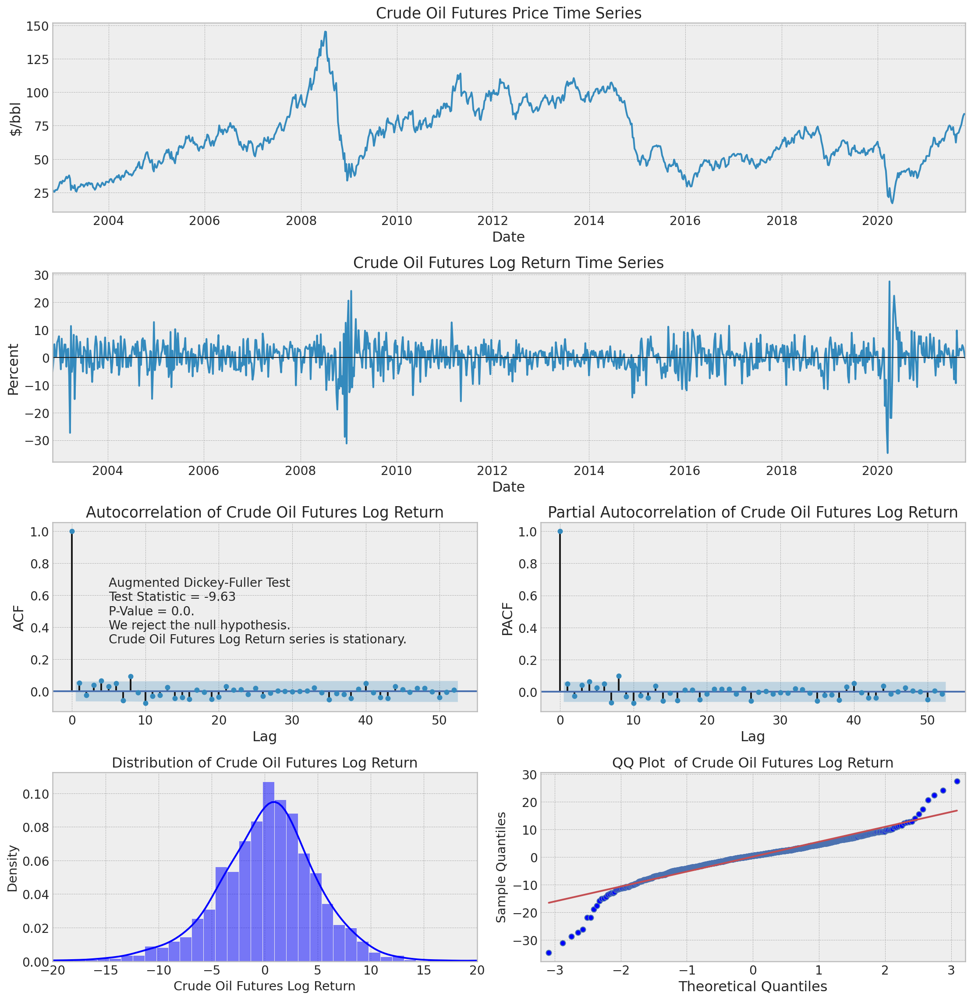

In [ ]:
tsplot(df['Crude Oil Futures Price'],estimation_data['Crude Oil Futures Log Return'], ts_unit='$/bbl', rtn_unit='Percent',lim=[-20,20])

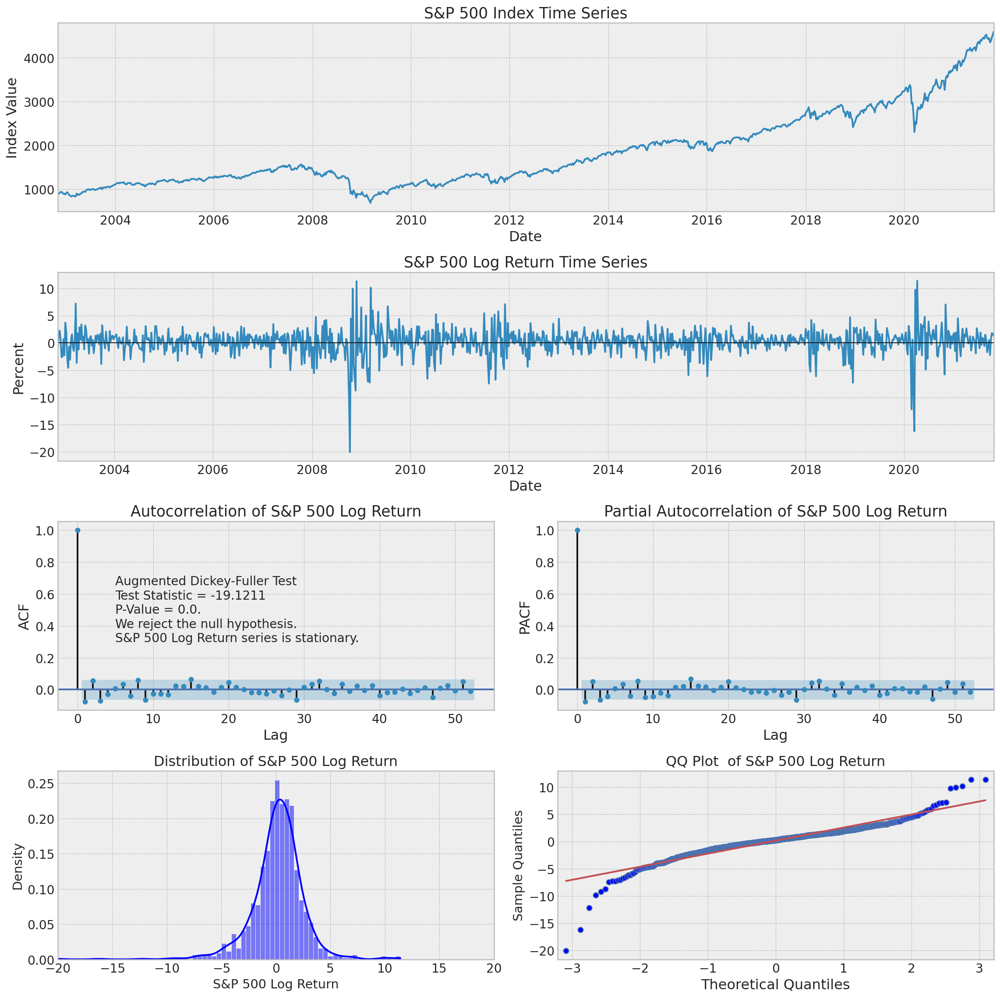

In [ ]:
tsplot(df['S&P 500 Index'],estimation_data['S&P 500 Log Return'], ts_unit='Index Value', rtn_unit='Percent',lim=[-20,20])

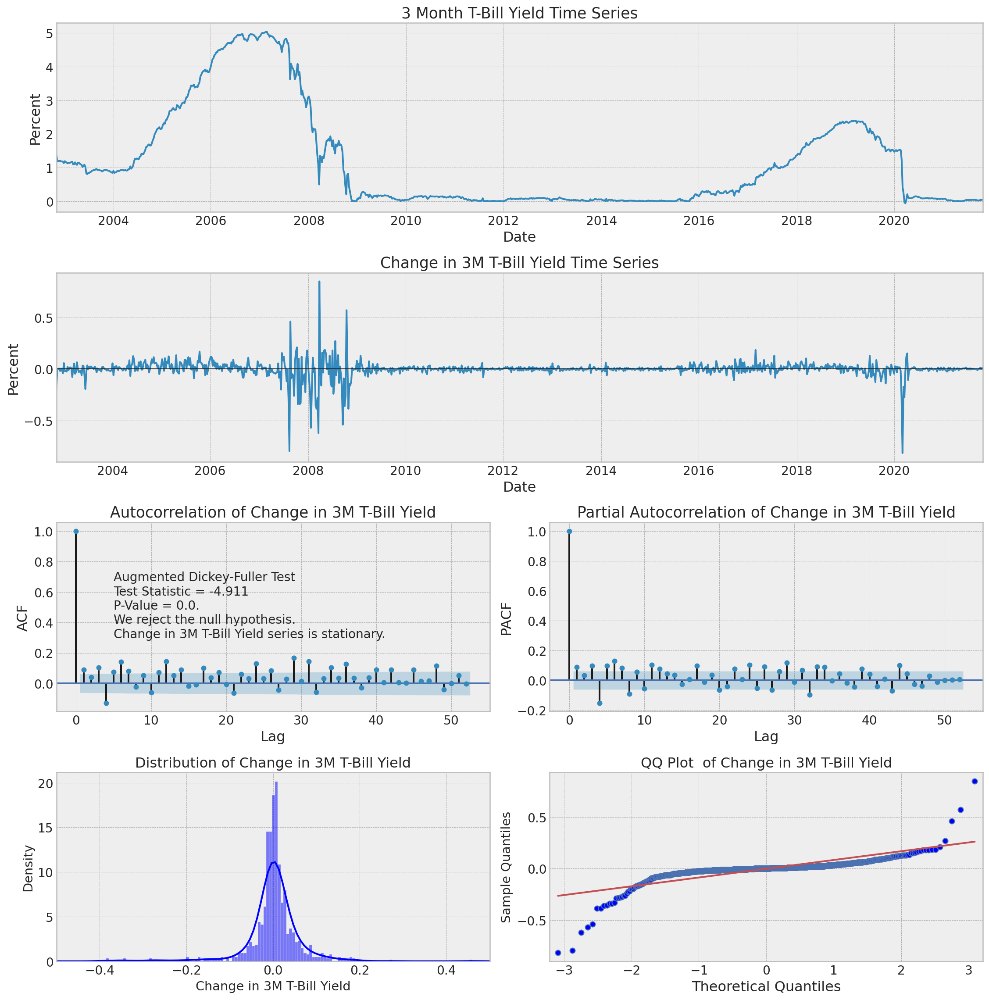

In [ ]:
tsplot(df['3 Month T-Bill Yield'],estimation_data['Change in 3M T-Bill Yield'] , ts_unit='Percent', rtn_unit='Percent',lim=[-0.5,0.5])

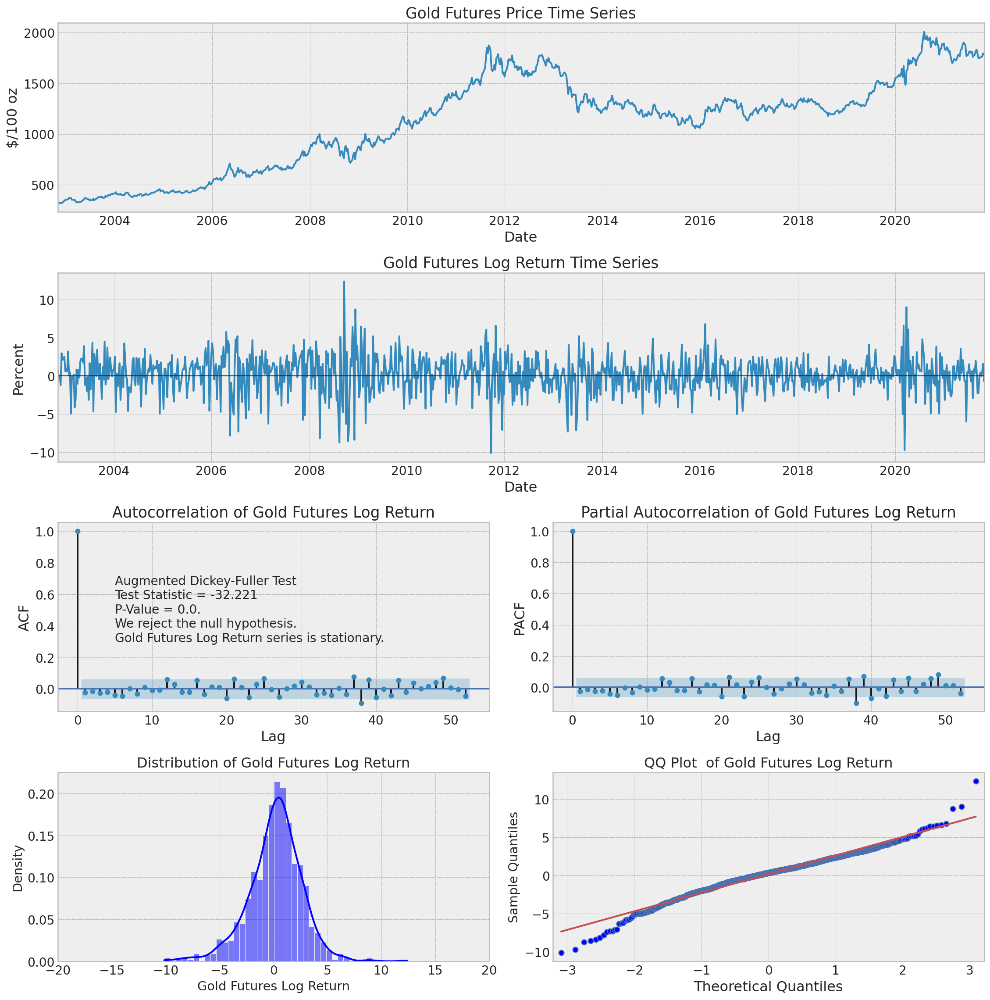

In [ ]:
tsplot(df['Gold Futures Price'],estimation_data['Gold Futures Log Return'] , ts_unit='$/100 oz', rtn_unit='Percent',lim=[-20,20])

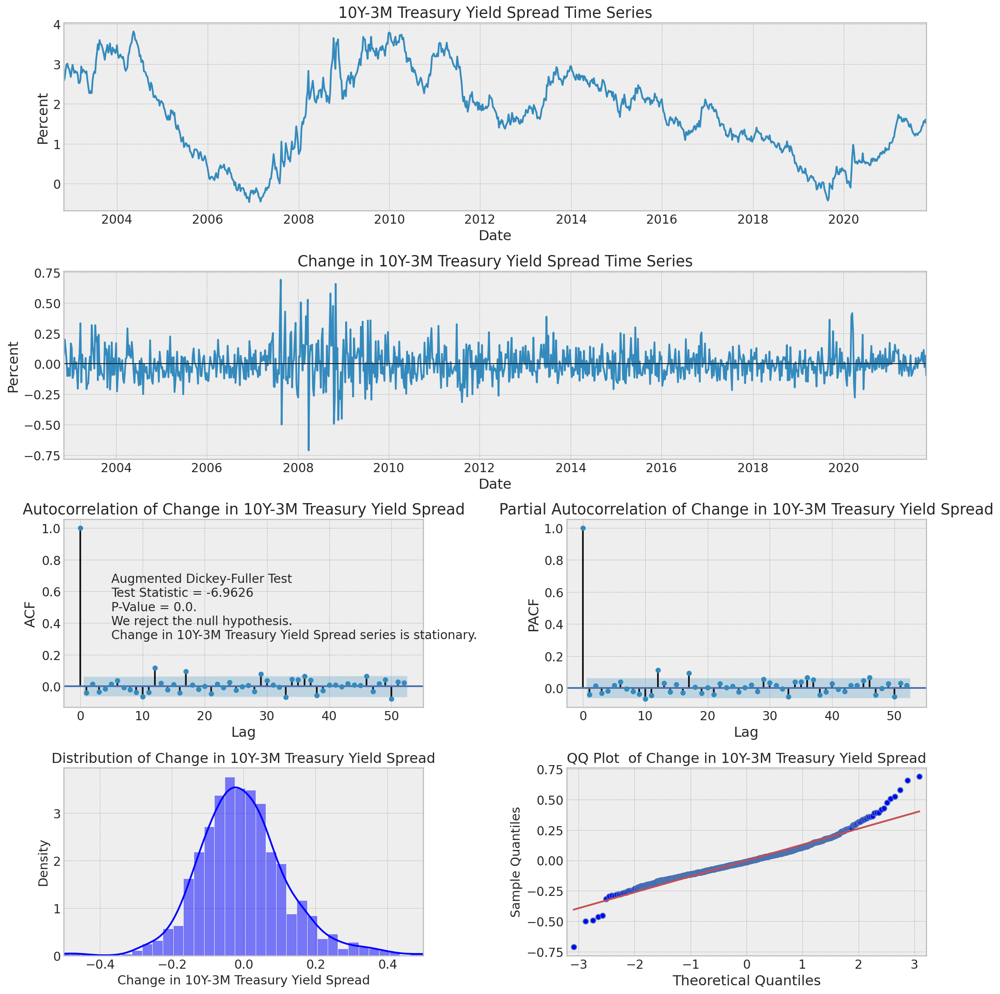

In [ ]:
tsplot(df['10Y-3M Treasury Yield Spread'],estimation_data['Change in 10Y-3M Treasury Yield Spread'],ts_unit='Percent', rtn_unit='Percent',lim=[-0.5,0.5])

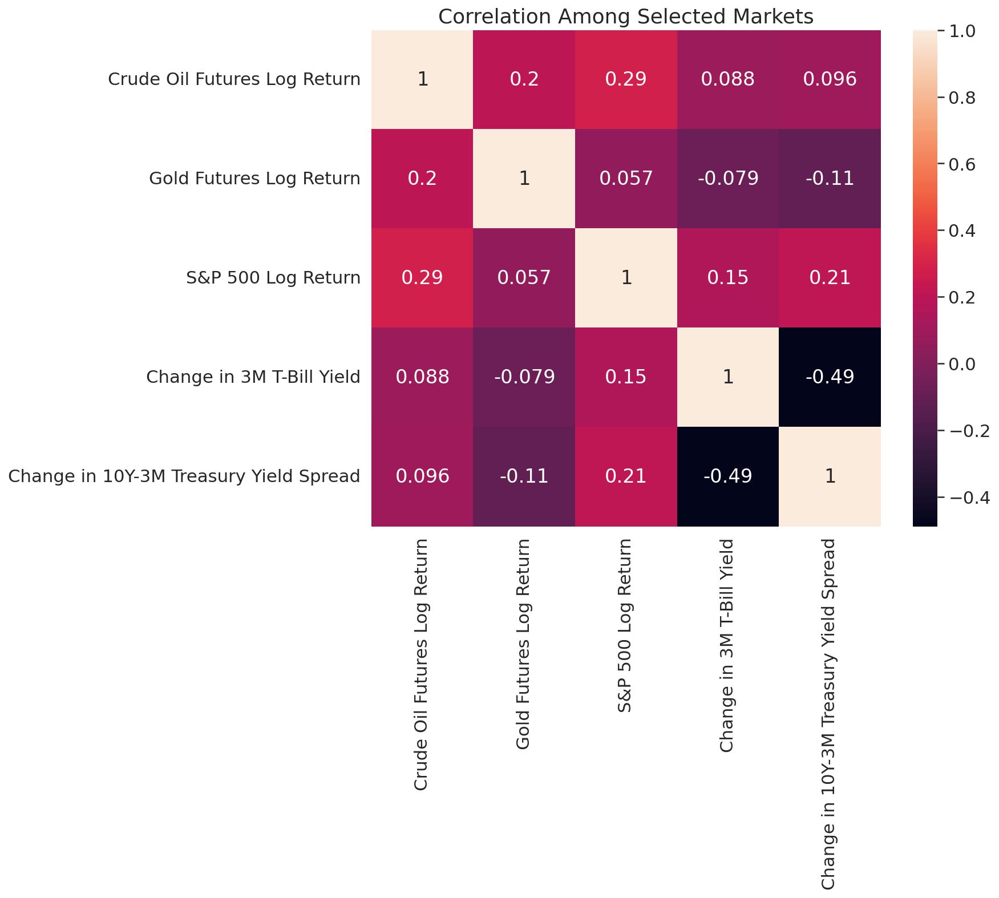

In [ ]:
'''correlation among predictors'''

def Corrplot(df):
  sns.set(font_scale=1.4)
  fig=plt.figure(figsize=[10,8])
  ax=fig.add_subplot()
  sns.heatmap(df.corr(),annot=True,ax=ax)
  ax.set_title('Correlation Among Selected Markets',fontsize=18)

Corrplot(estimation_data)

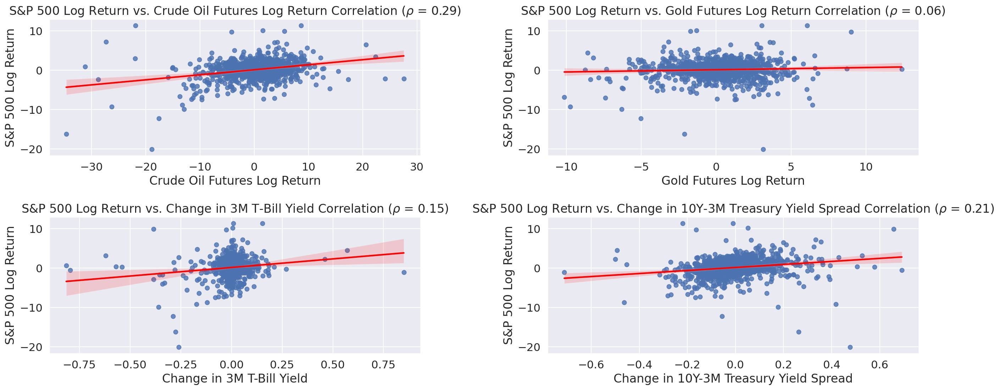

In [ ]:
'''visualizing the scatterplot and correlation'''

def Regplot(df):

  fig,ax=plt.subplots(nrows=(len(df.columns)-1)//2,ncols=2,sharex=False,sharey=False,figsize=[20,8])

  ax = np.ravel(ax)
  j = list(df.columns).index('S&P 500 Log Return')
  k = 0
  for i in range(len(df.columns)):
    if i != j:
      corr_coeff = df.iloc[:,i].corr(df.iloc[:,j])
      sns.regplot(x=df.columns[i], y='S&P 500 Log Return', data=df, 
                 line_kws={'color': 'red'},ax = ax[k])
      ax[k].set_title(f'S&P 500 Log Return vs. {df.columns[i]} Correlation ($\\rho$ = {corr_coeff:.2f})')
      ax[k].xaxis.set_tick_params(labelbottom=True)
      ax[k].yaxis.set_tick_params(labelbottom=True)
      k = k + 1
  plt.tight_layout()

Regplot(estimation_data)

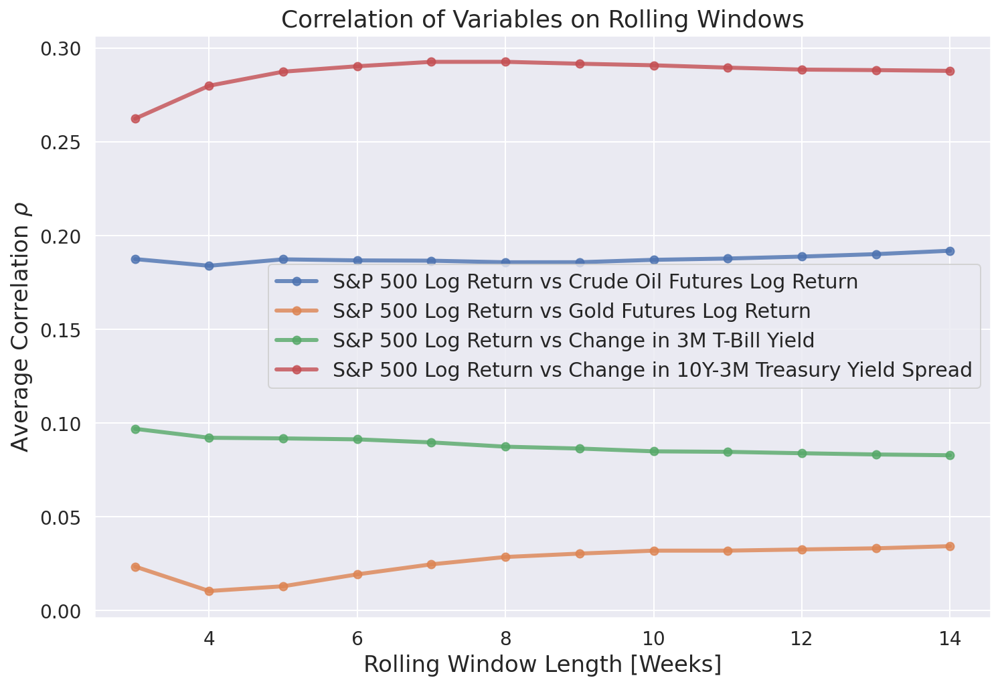

In [ ]:
'''correlation on rolling windows'''

def Rolling_Corrplot(df,windows):

  plt.figure(figsize=(12,8))

  for i in range(len(df.columns)):
    j = list(df.columns).index('S&P 500 Log Return')
    if i != j:
      r=[]
      for win in windows:
          r.append(df.iloc[:,j].rolling(win).corr(df.iloc[:,i]).mean())
      plt.plot(windows, r, '-o',alpha=0.8, label= df.columns[j]+' vs '+df.columns[i],lw=3)

  plt.legend(fontsize=15)
  plt.xlabel('Rolling Window Length [Weeks]', fontsize=17)
  plt.ylabel(r'Average Correlation $\rho$', fontsize=17)
  plt.title('Correlation of Variables on Rolling Windows', fontsize=18)
  plt.tick_params(labelsize=14)
  plt.show()

Rolling_Corrplot(estimation_data,range(3,15))

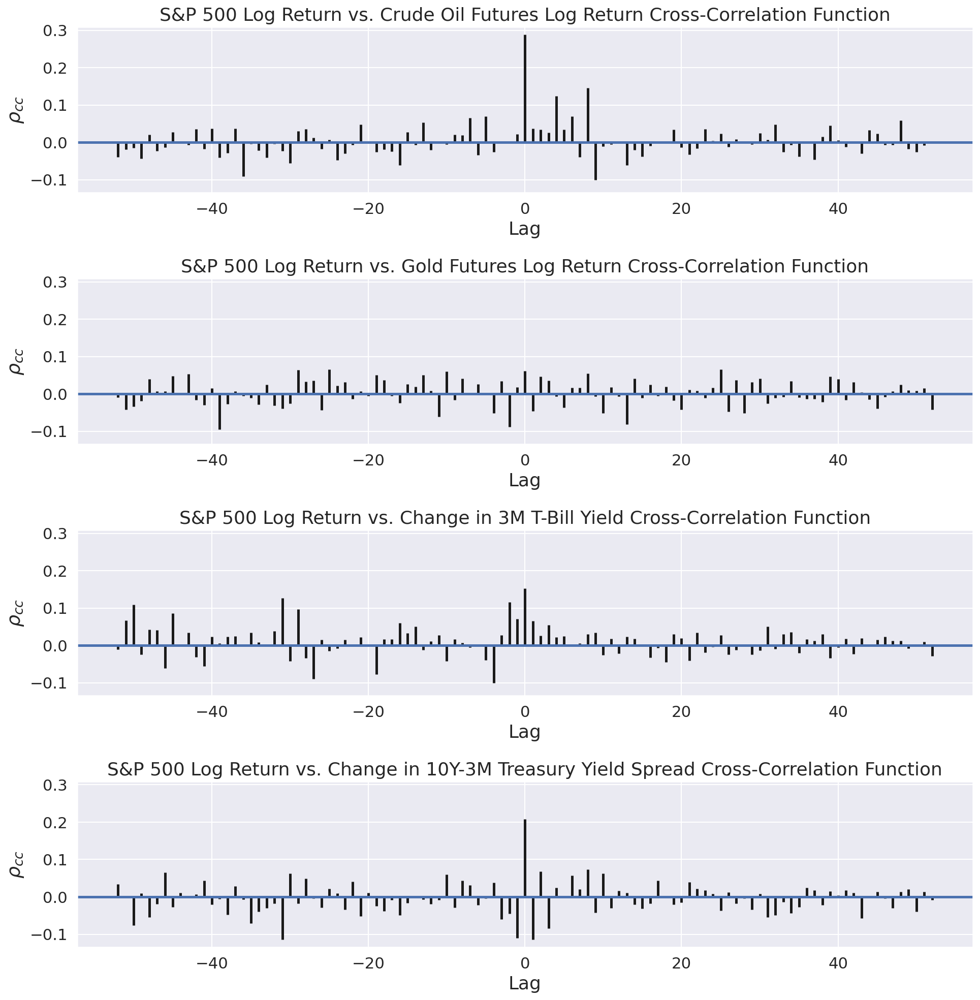

In [ ]:
'''cross-correlation'''


def CrossCorrplot(df,maxlags):

  fig,ax=plt.subplots(nrows=len(df.columns)-1,ncols=1,sharex=True,sharey=True,figsize=[14,14])

  j = list(df.columns).index('S&P 500 Log Return')
  k = 0
  for i in range(len(df.columns)):
    if i != j:
      ax[k].xcorr(df.iloc[:,i],df.iloc[:,j], usevlines=True, maxlags=maxlags, normed=True, lw=2.5)
      ax[k].set_title(f'S&P 500 Log Return vs. {df.columns[i]} Cross-Correlation Function',fontsize=18)
      ax[k].set_ylabel(r'$\rho_{cc}$',fontsize=19)
      ax[k].set_xlabel('Lag',fontsize=18)
      ax[k].xaxis.set_tick_params(labelbottom=True)
      k = k + 1
  plt.tight_layout()
CrossCorrplot(estimation_data,maxlags = 52)

In [ ]:
'''Granger Causality Test'''

'''Note granger causality means that past values of x have a statistically significant effect on the current value of y'''


def grangers_causality(df, col_names, test='ssr_chi2test', maxlag=52):    

    matrix = pd.DataFrame(np.zeros((len(col_names), len(col_names))), columns=col_names, index=col_names)

    for col in matrix.columns:
        for row in matrix.index:
            test_output = grangercausalitytests(df[[row, col]], maxlag=maxlag,verbose=False)
            p_values = [round(test_output[i][0][test][1],4) for i in range(1,maxlag+1)]
            matrix.loc[row, col] = np.min(p_values)
    matrix.columns = [col + '_x' for col in matrix.columns]
    matrix.index = [row + '_y' for row in matrix.index]
    return matrix

grangers_causality(estimation_data, col_names = estimation_data.columns)

,Crude Oil Futures Log Return_x,Gold Futures Log Return_x,S&P 500 Log Return_x,Change in 3M T-Bill Yield_x,Change in 10Y-3M Treasury Yield Spread_x
Crude Oil Futures Log Return_y,1.0000,0.0384,0.0000,0.0,0.0001
Gold Futures Log Return_y,0.0803,1.0000,0.0527,0.0,0.0007
S&P 500 Log Return_y,0.0012,0.0008,1.0000,0.0,0.0001
Change in 3M T-Bill Yield_y,0.1046,0.2924,0.0844,1.0,0.0010
Change in 10Y-3M Treasury Yield Spread_y,0.0057,0.0026,0.0002,0.0,1.0000


<a id="part7"></a>

## Baseline Model 1: Historical Mean

[Return to contents](#contents) 


In [ ]:
models = []

Text(0, 0.5, 'Percent')

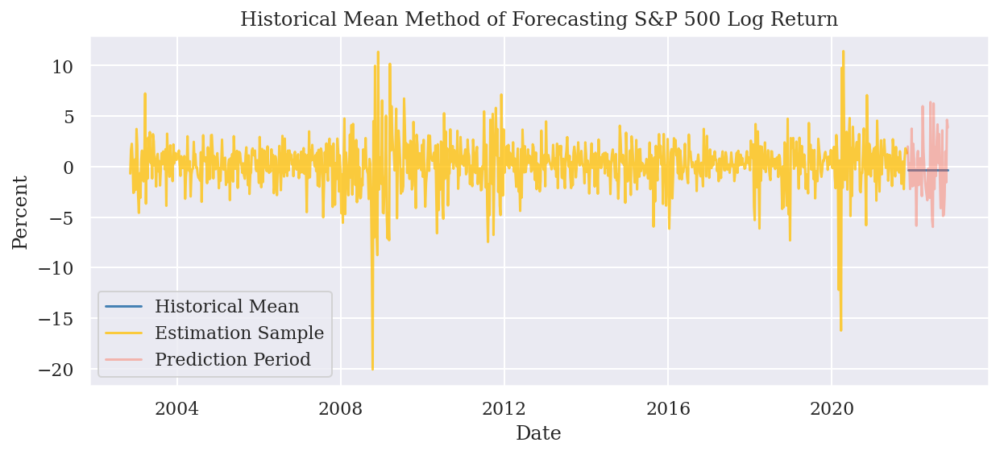

In [ ]:
'''Visualization'''

Model1_forecast = test_data.copy()[['S&P 500 Log Return']]
Model1_forecast['S&P 500 Log Return'] = np.mean(test_data['S&P 500 Log Return'].values)

fig, ax = plt.subplots(nrows =1 ,ncols=1,figsize=[10,4])
ax.plot(Model1_forecast,label='Historical Mean')
ax.plot(estimation_data['S&P 500 Log Return'],alpha=0.8,label = 'Estimation Sample')
ax.plot(test_data['S&P 500 Log Return'],alpha=0.4,label = 'Prediction Period')
ax.legend() 
ax.set_title('Historical Mean Method of Forecasting S&P 500 Log Return')
ax.set_xlabel('Date')
ax.set_ylabel('Percent')

In [ ]:
'''Performance Metrics'''

model1_R2 = r2_score(test_data['S&P 500 Log Return'],Model1_forecast)
model1_rmse = mse(test_data['S&P 500 Log Return'],Model1_forecast, squared=False)
model1_mape = mape(test_data['S&P 500 Log Return'],Model1_forecast)
print('R2: ',model1_R2)
print('RMSE: ',model1_rmse)
print('MAPE: ',model1_mape)

R2:  0.0
RMSE:  3.0769923805922588
MAPE:  1.0689571874940837


In [ ]:
'''Save metrics for comparison'''

model1_results = {'rmse':[model1_rmse,model1_rmse,model1_rmse],
          'mape':[model1_mape,model1_mape,model1_mape],
          'R2':[model1_R2,model1_R2,model1_R2]}

models.append(model1_results)

<a id="part8"></a>

## Baseline Model 2: Naive Model

[Return to contents](#contents) 


Text(0, 0.5, 'Percent')

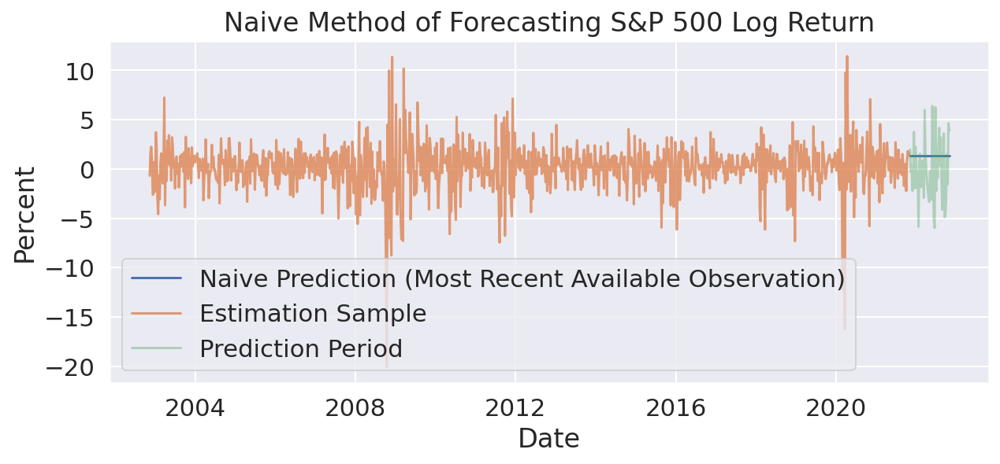

In [ ]:
'''Visualization'''

Model2_forecast = test_data.copy()[['S&P 500 Log Return']]
Model2_forecast['S&P 500 Log Return'] = estimation_data['S&P 500 Log Return'][-1]

fig, ax = plt.subplots(nrows =1 ,ncols=1,figsize=[10,4])
ax.plot(Model2_forecast,label='Naive Prediction (Most Recent Available Observation)')
ax.plot(estimation_data['S&P 500 Log Return'],alpha=0.8,label = 'Estimation Sample')
ax.plot(test_data['S&P 500 Log Return'],alpha=0.4,label = 'Prediction Period')
ax.legend() 
ax.set_title('Naive Method of Forecasting S&P 500 Log Return')
ax.set_xlabel('Date')
ax.set_ylabel('Percent')

In [ ]:
'''Performance Metrics'''

model2_R2 = r2_score(test_data['S&P 500 Log Return'],Model2_forecast)
model2_rmse = mse(test_data['S&P 500 Log Return'],Model2_forecast, squared=False)
model2_mape = mape(test_data['S&P 500 Log Return'],Model2_forecast)
print('R2: ',model2_R2)
print('RMSE: ',model2_rmse)
print('MAPE: ',model2_mape)

R2:  -0.28446844468998744
RMSE:  3.4872906114383495
MAPE:  1.8922443347383924


In [ ]:
'''Save metrics for comparison'''

model2_results = {'rmse':[model2_rmse,model2_rmse,model2_rmse],
          'mape':[model2_mape,model2_mape,model2_mape],
          'R2':[model2_R2,model2_R2,model2_R2]}

models.append(model2_results)

<a id="part9"></a>

## Model 3: Autoregressive Model

[Return to contents](#contents) 


In [ ]:
full = df_rtn.copy()['S&P 500 Log Return']
train = estimation_data['S&P 500 Log Return']
test = test_data['S&P 500 Log Return']

In [ ]:
'''select order based on AIC and fit'''

sel = ar_select_order(train, maxlag=52, ic ='aic', old_names=False)
sel.ar_lags
res = sel.model.fit()
print(res.summary())

                            AutoReg Model Results                             
Dep. Variable:     S&P 500 Log Return   No. Observations:                  991
Model:                     AutoReg(4)   Log Likelihood               -2260.410
Method:               Conditional MLE   S.D. of innovations              2.390
Date:                Sun, 11 Dec 2022   AIC                              1.755
Time:                        20:44:17   BIC                              1.784
Sample:                    12-08-2002   HQIC                             1.766
                         - 10-31-2021                                         
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.1825      0.077      2.376      0.018       0.032       0.333
S&P 500 Log Return.L1    -0.0707      0.032     -2.221      0.026      -0.133      -0.008
S&P 500 

/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:132: FutureWarning: The 'freq' argument in Timestamp is deprecated and will be removed in a future version.
  date_key = Timestamp(key, freq=base_index.freq)


Text(0, 0.5, 'Percents')

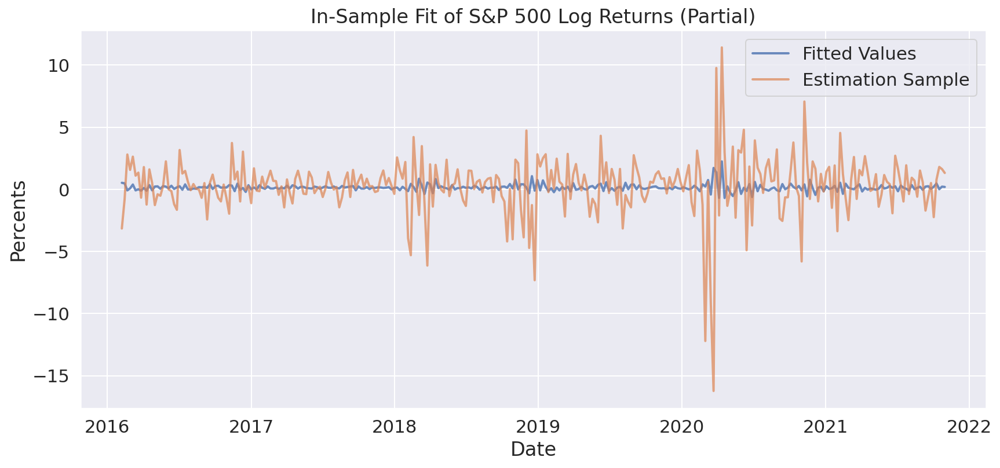

In [ ]:
'''In-sample prediction'''

fig, ax = plt.subplots(nrows =1, ncols =1 ,figsize=[14,6])

ax.plot(res.fittedvalues[-300:],alpha=0.8,label='Fitted Values',lw = 2)
ax.plot(train[-300:],alpha=0.7,label = 'Estimation Sample',lw = 2)
ax.legend()

ax.set_title("In-Sample Fit of S&P 500 Log Returns (Partial)")
ax.set_xlabel('Date')
ax.set_ylabel('Percents')

/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:132: FutureWarning: The 'freq' argument in Timestamp is deprecated and will be removed in a future version.
  date_key = Timestamp(key, freq=base_index.freq)


Text(0, 0.5, 'Percent')

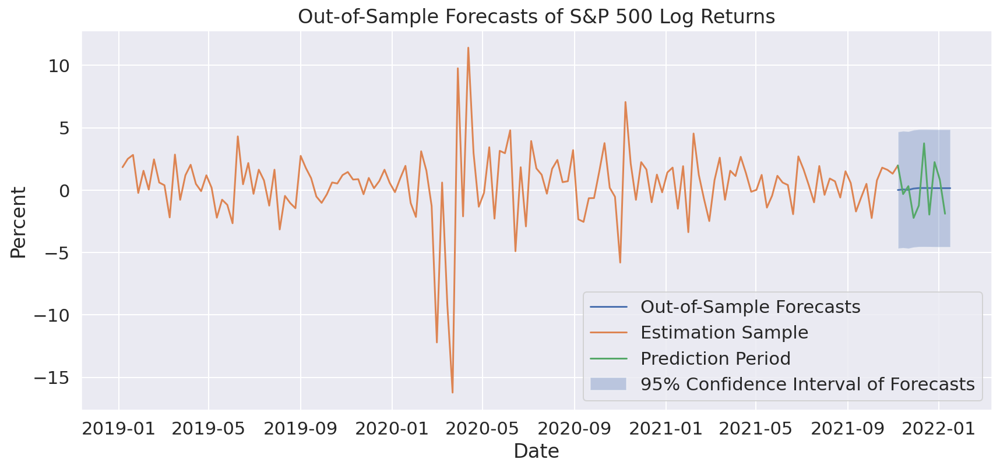

In [ ]:
'''Out-of-Sample Forecasts'''

fig, ax = plt.subplots(nrows =1, ncols =1 ,figsize=[14,6])

pred = res.get_prediction(start = test.index[0],end = test.index[10])
ax.plot(pred.predicted_mean,label='Out-of-Sample Forecasts')
ax.plot(df_rtn['S&P 500 Log Return'][-200:-test_size+1],label = 'Estimation Sample')
ax.plot(df_rtn['S&P 500 Log Return'][-test_size:-test_size+10],label = 'Prediction Period')
ax.fill_between(pred.conf_int().index, pred.conf_int().iloc[:,0], pred.conf_int().iloc[:,1],alpha=0.3,label='95% Confidence Interval of Forecasts')

ax.set_title("Out-of-Sample Forecasts of S&P 500 Log Returns")
ax.set_xlabel('Date')
ax.legend()
ax.set_ylabel('Percent')

In [ ]:
'''create another model for multistep ahead OOS forecasts. 

This practice is justified by examples provided by statsmodels at 
https://www.statsmodels.org/dev/examples/notebooks/generated/autoregressions.html
where it says "Producing OOS forecasts requires two models. The first must exclude 
the OOS period. The second uses the predict method from the full-sample model 
with the parameters from the shorter sample model that excluded the OOS period."'''

sel2 = ar_select_order(full , maxlag=52, ic ='aic', old_names=False)
sel2.ar_lags
res2 = sel2.model.fit()
res2.params = res.params 

In [ ]:
'''helper for multisteps ahead forecast'''
dates = test.index.tolist()

def forecast(start, steps=3):
  idx = dates.index(start)
  end = dates[idx+steps-1]
  return res2.predict(start, end, dynamic = True)

/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/base/tsa_model.py:132: FutureWarning: The 'freq' argument in Timestamp is deprecated and will be removed in a future version.
  date_key = Timestamp(key, freq=base_index.freq)


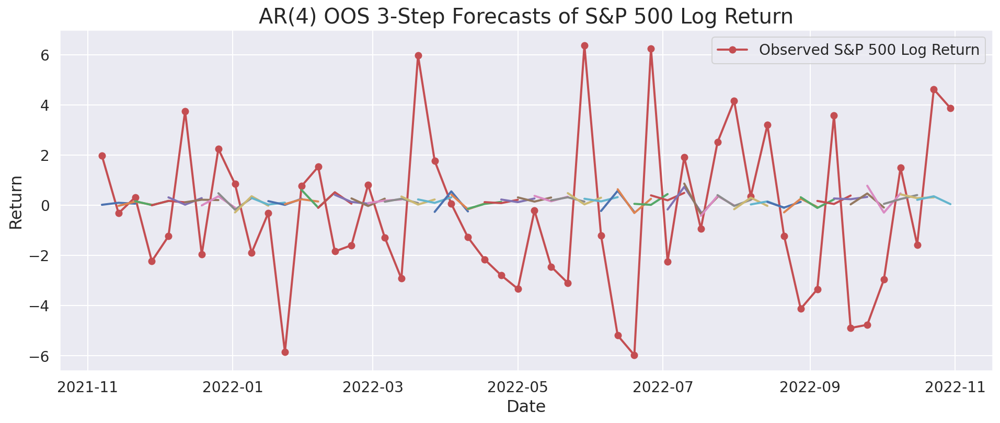

In [ ]:
'''Out-of-sample 3-step Forecasts'''

steps = 3
preds = []
actuals = []
lag_order = res.ar_lags[-1]
name=test.name

for start_date in dates[:-steps+1]:

    pred = forecast(start = start_date, steps=steps)
    pred = pd.Series(pred,
                     index=pd.date_range(start_date, freq='W', periods=steps).date,
                     name=test.name)
    preds.append(pred)
    actual = test.loc[pred.index]
    actuals.append(actual)
    
fig,ax = plt.subplots(nrows=1,ncols=1,figsize=[16,6])
ax.plot(test,'r-o',lw=2,label =str('Observed '+ name) )
for pred in preds:
    ax.plot(pred,lw=2)
ax.set_title(f'AR({res.ar_lags[-1]}) OOS 3-Step Forecasts of '+name,fontsize=20)
ax.set_xlabel('Date',fontsize=16)
ax.set_ylabel('Return',fontsize=16)
ax.legend(fontsize=14)
ax.tick_params(labelsize=14)
plt.show()

R2:  -0.06290400736655766
RMSE:  3.088087859126633
MAPE:  1.1201405252070584


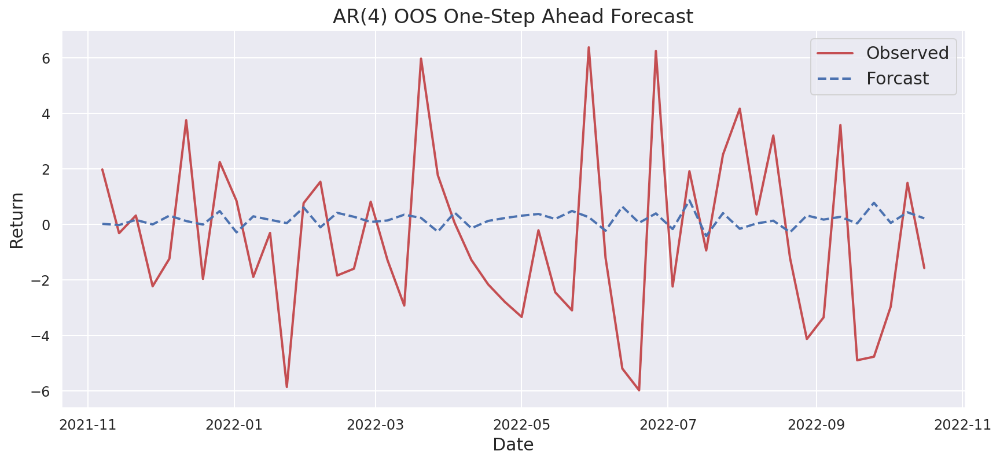

In [ ]:
'''Collecting 1-Step Ahead Forecasts'''

pred_step1 =  [pred[0:1] for pred in preds]
actual_step1 =  [actual[0:1] for actual in actuals]
actual_step1=pd.concat(actual_step1,ignore_index=False)
pred_step1=pd.concat(pred_step1,ignore_index=False)
    
plt.figure(figsize=[14,6])
plt.plot(actual_step1,'r',lw=2,label='Observed')
plt.plot(pred_step1,'b--',lw=2,label='Forcast')
plt.legend(fontsize=15)
plt.title(f'AR({res.ar_lags[-1]}) OOS One-Step Ahead Forecast',fontsize=17)
plt.xlabel('Date',fontsize=15)
plt.tick_params(labelsize=12)
plt.ylabel('Return',fontsize=15)

'''Performance Metrics'''
model3_step1_R2 = r2_score(actual_step1,pred_step1)
model3_step1_rmse = mse(actual_step1,pred_step1, squared=False)
model3_step1_mape = mape(actual_step1,pred_step1)

print('R2: ',model3_step1_R2)
print('RMSE: ',model3_step1_rmse)
print('MAPE: ',model3_step1_mape)

R2:  -0.046965012061048306
RMSE:  3.1324205357166797
MAPE:  1.1422304422416731


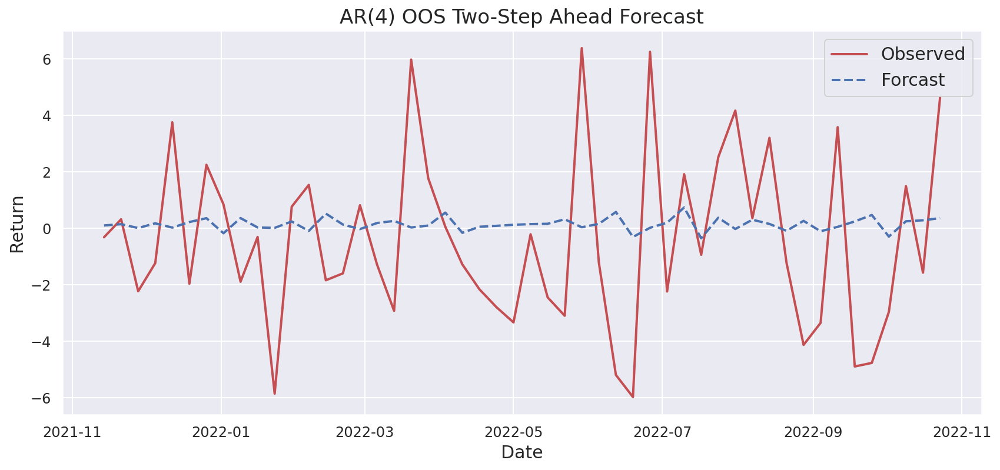

In [ ]:
'''Collecting 2-Step Ahead Forecasts'''

pred_step2 =  [pred[1:2] for pred in preds]
actual_step2 =  [actual[1:2] for actual in actuals]
actual_step2 = pd.concat(actual_step2,ignore_index=False)
pred_step2 = pd.concat(pred_step2,ignore_index=False)
    
plt.figure(figsize=[14,6])
plt.plot(actual_step2,'r',lw=2,label='Observed')
plt.plot(pred_step2,'b--',lw=2,label='Forcast')
plt.legend(fontsize=15)
plt.title(f'AR({res.ar_lags[-1]}) OOS Two-Step Ahead Forecast',fontsize=17)
plt.xlabel('Date',fontsize=15)
plt.tick_params(labelsize=12)
plt.ylabel('Return',fontsize=15)

'''Performance Metrics'''
model3_step2_R2 = r2_score(actual_step2, pred_step2)
model3_step2_rmse = mse(actual_step2,pred_step2, squared=False)
model3_step2_mape = mape(actual_step2,pred_step2)

print('R2: ',model3_step2_R2)
print('RMSE: ',model3_step2_rmse)
print('MAPE: ',model3_step2_mape)

R2:  -0.03027976781853914
RMSE:  3.1675732114887274
MAPE:  1.076834422386248


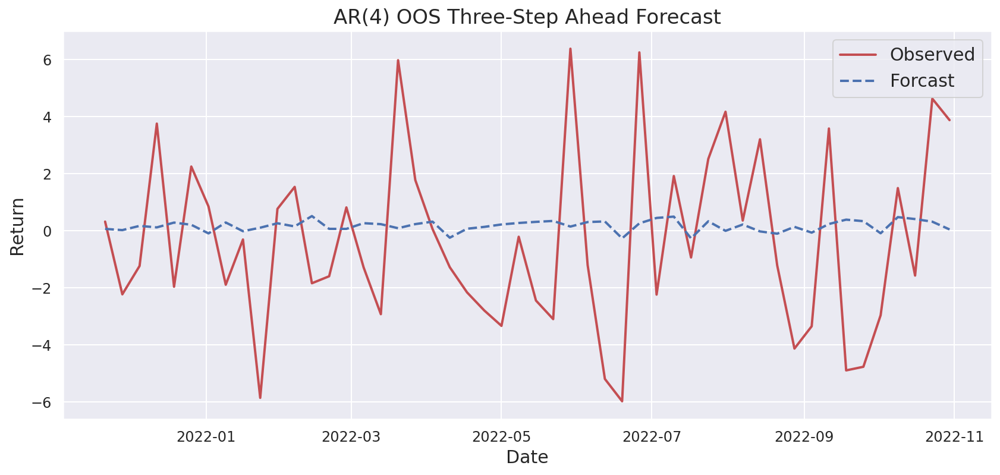

In [ ]:
'''Collecting 3-Step Ahead Forecasts'''

pred_step3 =  [pred[2:] for pred in preds]
actual_step3 =  [actual[2:] for actual in actuals]
actual_step3 = pd.concat(actual_step3,ignore_index=False)
pred_step3 = pd.concat(pred_step3,ignore_index=False)
    
plt.figure(figsize=[14,6])
plt.plot(actual_step3,'r',lw=2,label='Observed')
plt.plot(pred_step3,'b--',lw=2,label='Forcast')
plt.legend(fontsize=15)
plt.title(f'AR({res.ar_lags[-1]}) OOS Three-Step Ahead Forecast',fontsize=17)
plt.xlabel('Date',fontsize=15)
plt.tick_params(labelsize=12)
plt.ylabel('Return',fontsize=15)

'''Performance Metrics'''
model3_step3_R2 = r2_score(actual_step3,pred_step3)
model3_step3_rmse = mse(actual_step3,pred_step3, squared=False)
model3_step3_mape = mape(actual_step3,pred_step3)
print('R2: ',model3_step3_R2)
print('RMSE: ',model3_step3_rmse)
print('MAPE: ',model3_step3_mape)

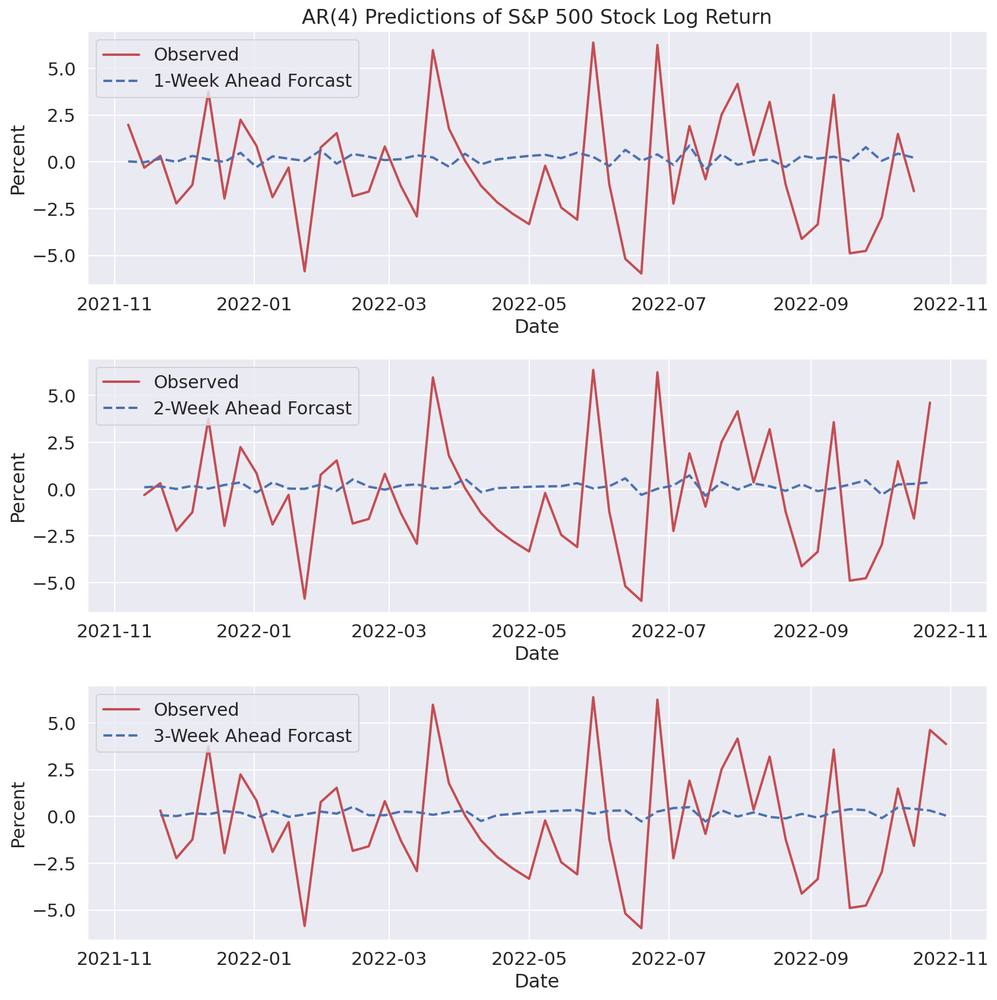

In [ ]:
fig,axes=plt.subplots(nrows=3,ncols=1,figsize=[12,12],sharex=True,sharey=True)

axes[0].plot(actual_step1,'r',lw=2,label='Observed')
axes[0].plot(pred_step1,'b--',lw=2,label='1-Week Ahead Forcast')
axes[0].set_ylabel('Percent',fontsize=16)
axes[0].set_title('AR(4) Predictions of S&P 500 Stock Log Return',fontsize=17)
axes[0].legend(fontsize=15)
axes[0].xaxis.set_tick_params(labelbottom=True)
axes[0].set_xlabel('Date',fontsize=16)

axes[1].plot(actual_step2,'r',lw=2,label='Observed')
axes[1].plot(pred_step2,'b--',lw=2,label='2-Week Ahead Forcast')
axes[1].set_ylabel('Percent',fontsize=16)
axes[1].legend(fontsize=15)
axes[1].xaxis.set_tick_params(labelbottom=True)
axes[1].set_xlabel('Date',fontsize=16)

axes[2].plot(actual_step3,'r',lw=2,label='Observed')
axes[2].plot(pred_step3,'b--',lw=2,label='3-Week Ahead Forcast')
axes[2].set_ylabel('Percent',fontsize=15)
axes[2].legend(fontsize=15)
axes[2].xaxis.set_tick_params(labelbottom=True)
axes[2].set_xlabel('Date',fontsize=16)

plt.tight_layout()


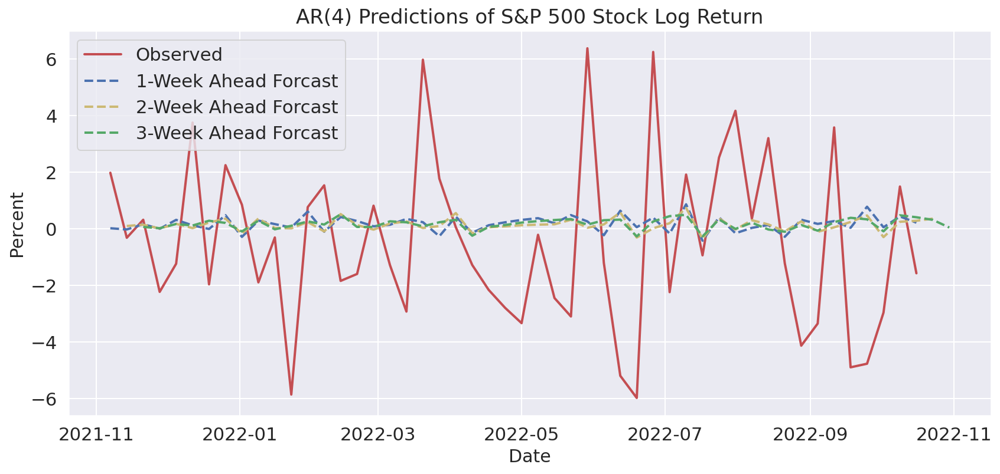

In [ ]:
fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True,sharey=True)

ax.plot(actual_step1,'r',lw=2,label='Observed')

ax.plot(pred_step1,'b--',lw=2,label='1-Week Ahead Forcast')
ax.set_ylabel('Percent',fontsize=15)
ax.set_xlabel('Date',fontsize=15)
ax.set_title('AR(4) Predictions of S&P 500 Stock Log Return',fontsize=17)
ax.legend(fontsize=15)
ax.plot(pred_step2,'y--',lw=2,label='2-Week Ahead Forcast')
ax.plot(pred_step3,'g--',lw=2,label='3-Week Ahead Forcast')
ax.legend()

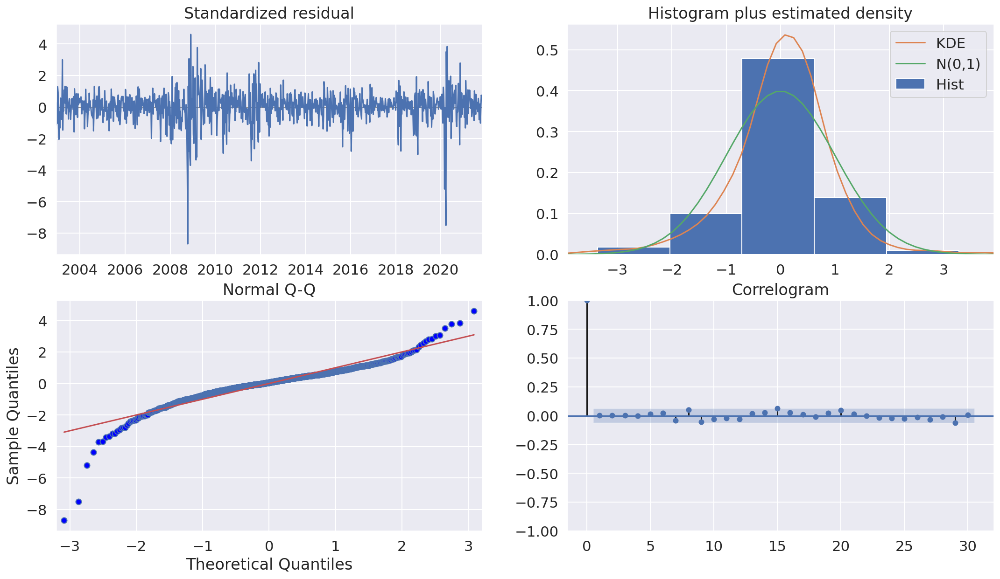

In [ ]:
'''Diagonstics and Ljung-Box test'''

fig = plt.figure(figsize=(18, 10))
fig = res.plot_diagnostics(fig=fig, lags=30)

In [ ]:
'''Perform the Ljung-Box test'''

lb_test = acorr_ljungbox(res.resid , lags = 10, return_df = True)
print('P-values are: ', lb_test.iloc[0,1])

P-values are:  0.9858397959630847


In [ ]:
'''Store the metrics'''

model3_results = {'rmse':[model3_step1_rmse,model3_step2_rmse,model3_step3_rmse],
          'mape':[model3_step1_mape,model3_step2_mape,model3_step3_mape],
          'R2':[model3_step1_R2,model3_step3_R2,model3_step3_R2]}

models.append(model3_results)
models

[{'rmse': [3.0769923805922588, 3.0769923805922588, 3.0769923805922588],
  'mape': [1.0689571874940837, 1.0689571874940837, 1.0689571874940837],
  'R2': [0.0, 0.0, 0.0]},
 {'rmse': [3.4872906114383495, 3.4872906114383495, 3.4872906114383495],
  'mape': [1.8922443347383924, 1.8922443347383924, 1.8922443347383924],
  'R2': [-0.28446844468998744, -0.28446844468998744, -0.28446844468998744]},
 {'rmse': [3.088087859126633, 3.1324205357166797, 3.1675732114887274],
  'mape': [1.1201405252070584, 1.1422304422416731, 1.076834422386248],
  'R2': [-0.06290400736655766, -0.03027976781853914, -0.03027976781853914]},
 {'rmse': [3.088087859126633, 3.1324205357166797, 3.1675732114887274],
  'mape': [1.1201405252070584, 1.1422304422416731, 1.076834422386248],
  'R2': [-0.06290400736655766, -0.03027976781853914, -0.03027976781853914]}]

<a id="part10"></a>

## Model 4: Vector Autoregression

[Return to contents](#contents) 

In [ ]:
train, test = estimation_data, test_data
full = df_rtn

In [ ]:
'''Selecting order'''

var_model = smt.VAR(train)
varsel= var_model.select_order(maxlags=52)
print(varsel.summary())

 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -2.719     -2.693*     0.06594     -2.709*
1       -2.743      -2.588     0.06440      -2.684
2       -2.757      -2.473     0.06347      -2.649
3       -2.757      -2.345     0.06345      -2.600
4       -2.785      -2.243     0.06176      -2.578
5       -2.798      -2.127     0.06092      -2.543
6       -2.806      -2.007     0.06043      -2.502
7       -2.802      -1.874     0.06067      -2.448
8       -2.810      -1.753     0.06020      -2.407
9       -2.817      -1.630     0.05982      -2.364
10     -2.824*      -1.508    0.05940*      -2.322
11      -2.803      -1.358     0.06069      -2.252
12      -2.786      -1.213     0.06171      -2.186
13      -2.769      -1.067     0.06277      -2.120
14      -2.743     -0.9110     0.06449      -2.044
15      -2.731     -0.7703     0.06528      -1.983
16      -2.728     -0.6386     

In [ ]:
'''Fit VAR model based on AIC'''

results = var_model.fit(maxlags=52, ic='aic')
print(results.summary())

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Sun, 11, Dec, 2022
Time:                     20:45:41
--------------------------------------------------------------------
No. of Equations:         5.00000    BIC:                   -1.49386
Nobs:                     981.000    HQIC:                  -2.28118
Log likelihood:          -5348.86    FPE:                  0.0630314
AIC:                     -2.76459    Det(Omega_mle):       0.0489219
--------------------------------------------------------------------
Results for equation Crude Oil Futures Log Return
                                                coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------------------------------
const                                             -0.042337         0.176282           -0.240           0.810
L1.Crude Oil Futures Log Return

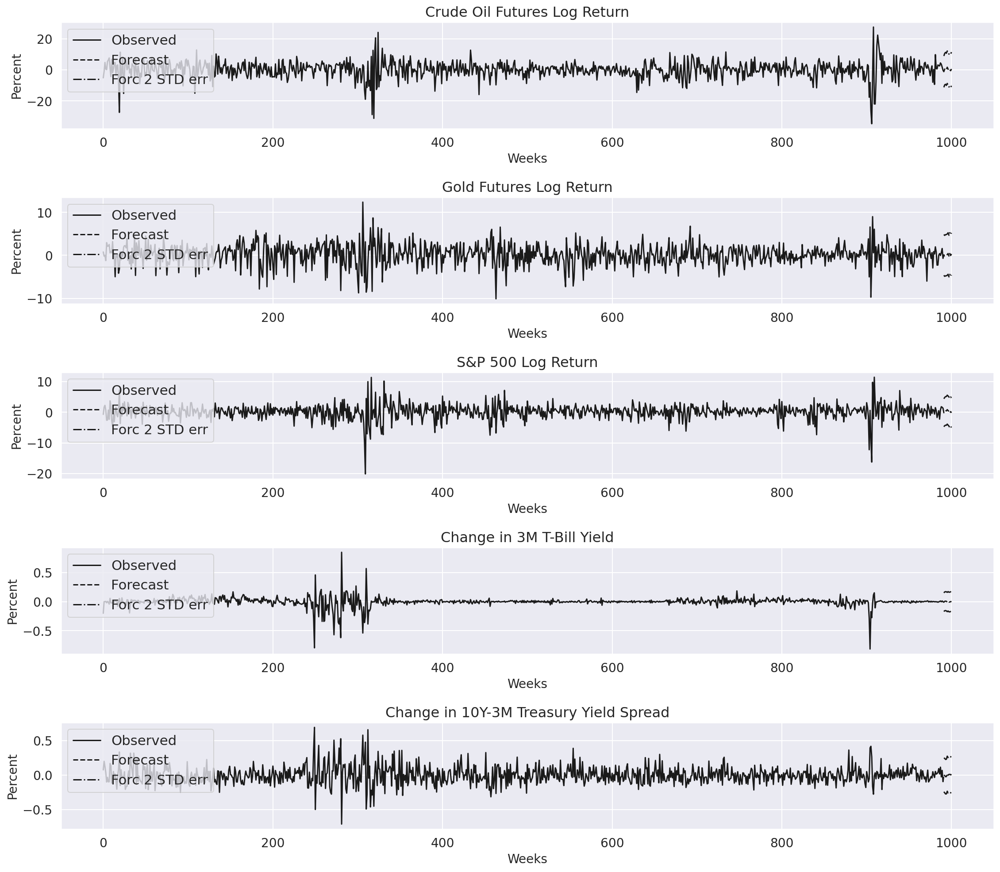

In [ ]:
'''plot forecasts and standard deviation'''

fig = results.plot_forecast(10)
for i in range(len(train.columns)):
  ax = fig.get_axes()[i]
  ax.legend(loc='upper left')
  ax.set_xlabel(f'Weeks',fontsize = 14)
  ax.set_ylabel('Percent',fontsize = 14)
  ax.tick_params(labelsize = 14)
  ax.set_title(train.columns[i],fontsize = 16)
fig.set_size_inches(16, 14)
plt.tight_layout()

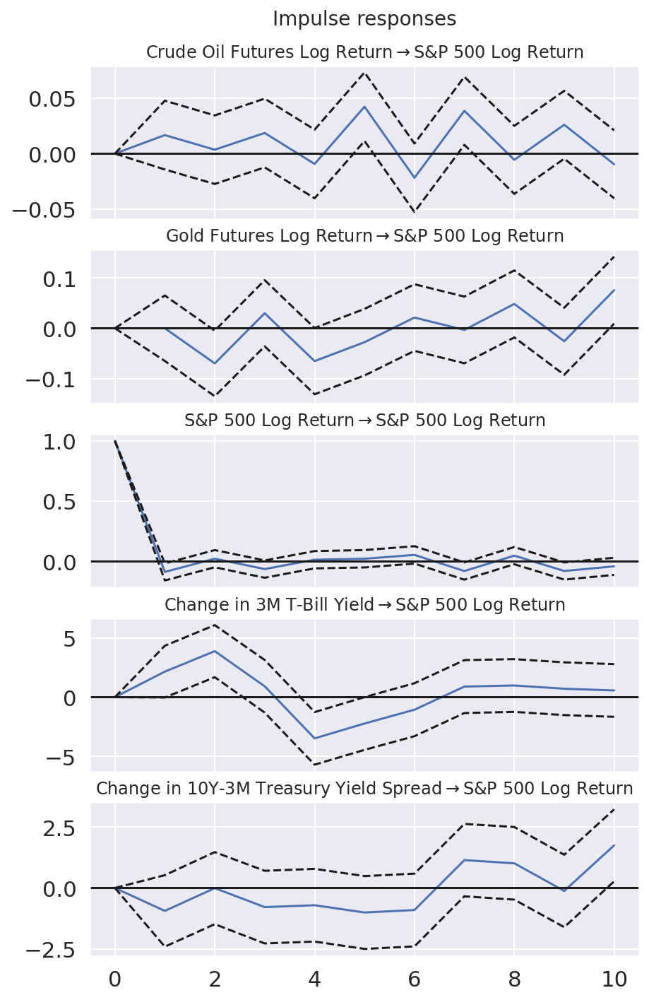

In [ ]:
'''Impulse Response Function'''

irf = results.irf(10)
fig=irf.plot(orth=False,response = 'S&P 500 Log Return')
fig.set_figheight(10)
fig.set_figwidth(6)
plt.show()

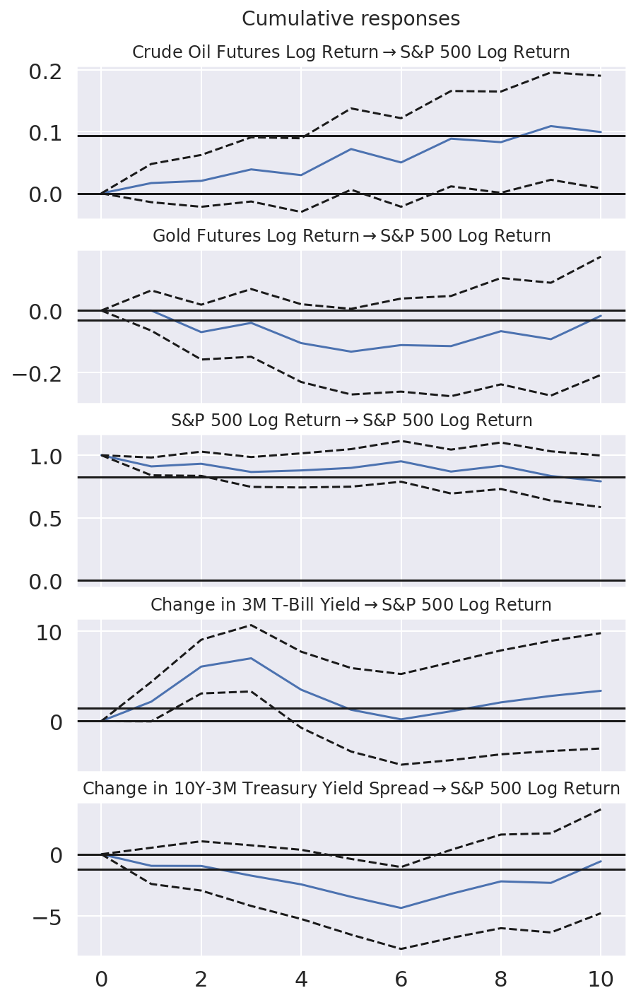

In [ ]:
'''Impulse Response Function'''

irf = results.irf(10)
fig=irf.plot_cum_effects(orth=False,response = 'S&P 500 Log Return')
fig.set_figheight(10)
fig.set_figwidth(6)
ax = fig.gca()
plt.show()

In [ ]:
'''helper for multisteps ahead forecast'''

dates = full.index.tolist()

def forecast(forecast_start_date, lag_order, steps=3):
  idx = dates.index(forecast_start_date)
  input_start_date = dates[idx-lag_order]
  input_end_date = dates[idx-1]
  input_data = full.loc[input_start_date:input_end_date]
  return results.forecast(input_data.values,steps=steps)

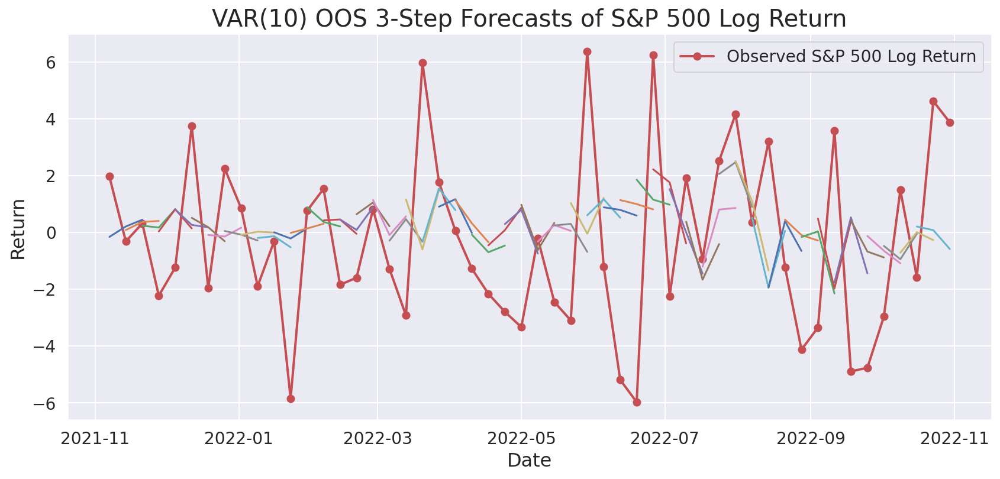

In [ ]:
'''out-of Sample 3-step forecast for SP500'''

steps = 3
preds = []
actuals = []
lag_order = results.k_ar
LABEL = True

for start_date in dates[-test_size:-steps+1]:

    pred = forecast(forecast_start_date = start_date, lag_order=lag_order, steps=steps)
    pred = pd.DataFrame(pred,
                        index=pd.date_range(start_date, freq='W', periods=steps).date,
                        columns = test.columns)
    preds.append(pred)
    
    actual = test.loc[pred.index]
    actuals.append(actual)

fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6])
ax.plot(test['S&P 500 Log Return'],'r-o',lw=2,label='Observed S&P 500 Log Return')

for pred in preds:
  ax.plot(pred['S&P 500 Log Return'])
ax.set_title(f'VAR({results.k_ar}) OOS 3-Step Forecasts of S&P 500 Log Return',fontsize=20)
ax.set_xlabel('Date',fontsize=16)
ax.set_ylabel('Return',fontsize=16)
ax.legend(fontsize=14)
ax.tick_params(labelsize=14)
plt.show()

In [ ]:
'''out-of Sample 3-step ahead forecast for others'''

'''For generating the GIFs only, please do not run this block'''

# import time
# time.sleep(5)

# steps = 3
# preds = []
# actuals = []
# lag_order = results.k_ar
# LABEL = True

# for start_date in dates[-test_size:-steps+1]:

#     pred = forecast(forecast_start_date = start_date, lag_order=lag_order, steps=steps)
#     pred = pd.DataFrame(pred,
#                         index=pd.date_range(start_date, freq='W', periods=steps).date,
#                         columns = test.columns)
#     preds.append(pred)
    
#     actual = test.loc[pred.index]
#     actuals.append(actual)

#     fig,axes=plt.subplots(nrows=2,ncols=2,sharex = True, figsize=[20,12])
    
#     i = 0
#     for ax in np.ravel(axes):
#       if test.columns[i] != 'S&P 500 Log Return':
#         ax.plot(test.iloc[:,i],'r-o',lw=2,label= f'Observed {test.columns[i]}')

#         for pred in preds[:-1]:
#           ax.plot(pred[test.columns[i]])
#         ax.plot(preds[-1][test.columns[i]],label= f'3-Week Forecasts Starting From {preds[-1].index[0]}')
#         ax.set_title(f'VAR({results.k_ar}) OOS 3-Steps Ahead Forecasts \n{test.columns[i]}',fontsize=20)
#         ax.set_xlabel('Date',fontsize=16)
#         ax.set_ylabel('Percent',fontsize=16)
#         ax.legend(fontsize=14)
#         ax.tick_params(labelsize=14)
#         i = i+1
#       else:
#         i = i+1
#         ax.plot(test.iloc[:,i],'r-o',lw=2,label= f'Observed {test.columns[i]}')

#         for pred in preds[:-1]:
#           ax.plot(pred[test.columns[i]])
#         ax.plot(preds[-1][test.columns[i]],label = f'3-Week Forecasts Starting From {preds[-1].index[0]}')
#         ax.set_title(f'VAR({results.k_ar}) OOS 3-Steps Ahead Forecasts \n{test.columns[i]}',fontsize=20)
#         ax.set_xlabel('Date',fontsize=16)
#         ax.set_ylabel('Percent',fontsize=16)
#         ax.legend(fontsize=14)
#         ax.tick_params(labelsize=14)
#         i = i+1
#     plt.tight_layout()
#     plt.show()
#     time.sleep(0.5)

'For generating the GIFs only, please do not run this block'

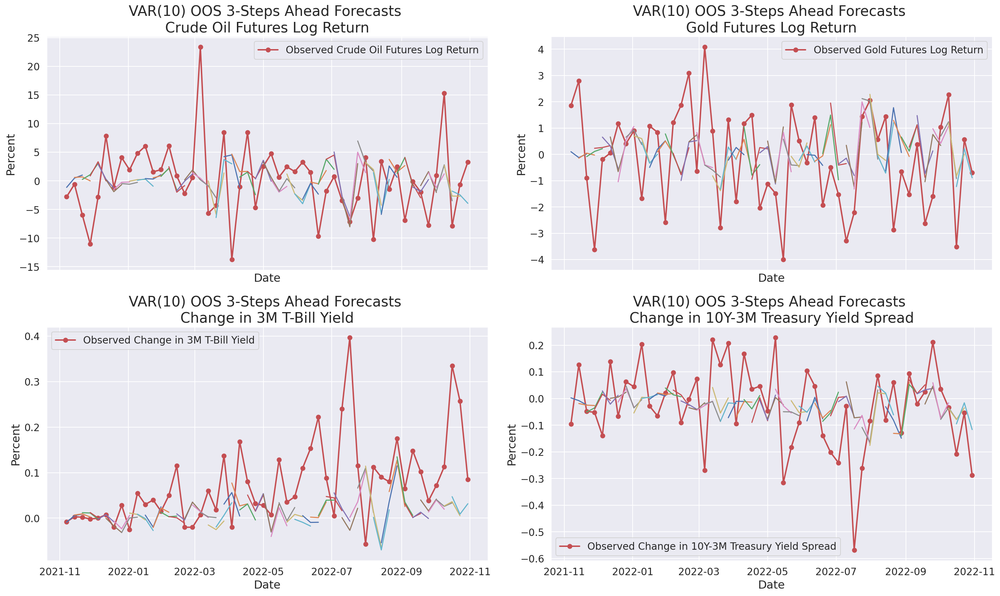

In [ ]:
steps = 3
preds = []
actuals = []
lag_order = results.k_ar
LABEL = True

for start_date in dates[-test_size:-steps+1]:

    pred = forecast(forecast_start_date = start_date, lag_order=lag_order, steps=steps)
    pred = pd.DataFrame(pred,
                        index=pd.date_range(start_date, freq='W', periods=steps).date,
                        columns = test.columns)
    preds.append(pred)
    
    actual = test.loc[pred.index]
    actuals.append(actual)

fig,axes=plt.subplots(nrows=2,ncols=2,sharex = True, figsize=[20,12])
    
i = 0
for ax in np.ravel(axes):
  if test.columns[i] != 'S&P 500 Log Return':
    ax.plot(test.iloc[:,i],'r-o',lw=2,label= f'Observed {test.columns[i]}')

    for pred in preds:
      ax.plot(pred[test.columns[i]])
    ax.set_title(f'VAR({results.k_ar}) OOS 3-Steps Ahead Forecasts \n{test.columns[i]}',fontsize=20)
    ax.set_xlabel('Date',fontsize=16)
    ax.set_ylabel('Percent',fontsize=16)
    ax.legend(fontsize=14)
    ax.tick_params(labelsize=14)
    i = i+1
  else:
    i = i+1
    ax.plot(test.iloc[:,i],'r-o',lw=2,label= f'Observed {test.columns[i]}')

    for pred in preds:
      ax.plot(pred[test.columns[i]])
    ax.set_title(f'VAR({results.k_ar}) OOS 3-Steps Ahead Forecasts \n{test.columns[i]}',fontsize=20)
    ax.set_xlabel('Date',fontsize=16)
    ax.set_ylabel('Percent',fontsize=16)
    ax.legend(fontsize=14)
    ax.tick_params(labelsize=14)
    i = i+1
plt.tight_layout()
plt.show()

R2:  -0.1709487552136093
RMSE:  3.2412428395710164
MAPE:  1.3203091535781168


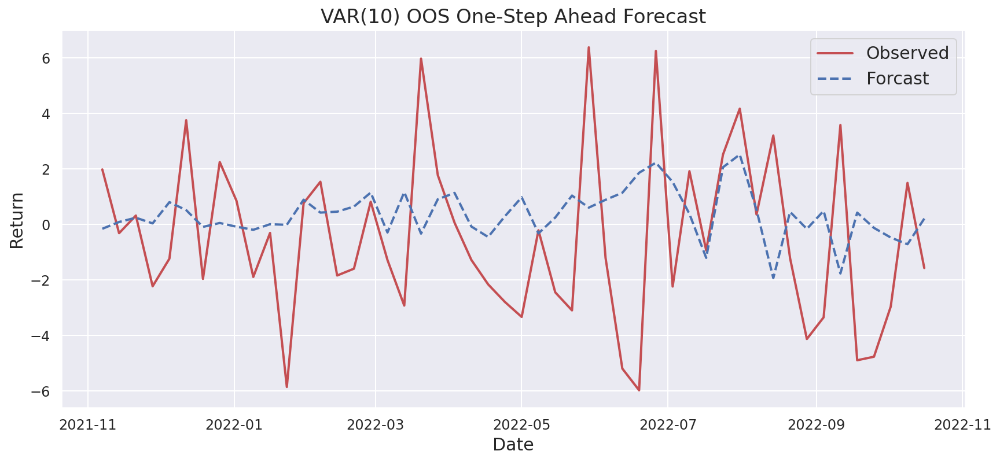

In [ ]:
'''Collecting 1-Step Ahead Forecasts'''

pred_step1 =  [pred['S&P 500 Log Return'][0:1] for pred in preds]
actual_step1 =  [actual['S&P 500 Log Return'][0:1] for actual in actuals]
actual_step1 = pd.concat(actual_step1,ignore_index=False)
pred_step1 = pd.concat(pred_step1,ignore_index=False)
    
plt.figure(figsize=[14,6])
plt.plot(actual_step1,'r',lw=2,label='Observed')
plt.plot(pred_step1,'b--',lw=2,label='Forcast')
plt.legend(fontsize=15)
plt.title(f'VAR({results.k_ar}) OOS One-Step Ahead Forecast',fontsize=17)
plt.xlabel('Date',fontsize=15)
plt.tick_params(labelsize=12)
plt.ylabel('Return',fontsize=15)

'''Performance Metrics'''
model4_step1_R2 = r2_score(actual_step1, pred_step1)
model4_step1_rmse = mse(actual_step1,pred_step1, squared=False)
model4_step1_mape = mape(actual_step1,pred_step1)

print('R2: ',model4_step1_R2)
print('RMSE: ',model4_step1_rmse)
print('MAPE: ',model4_step1_mape)

R2:  -0.14666705372817468
RMSE:  3.278178861046895
MAPE:  1.4187972580981407


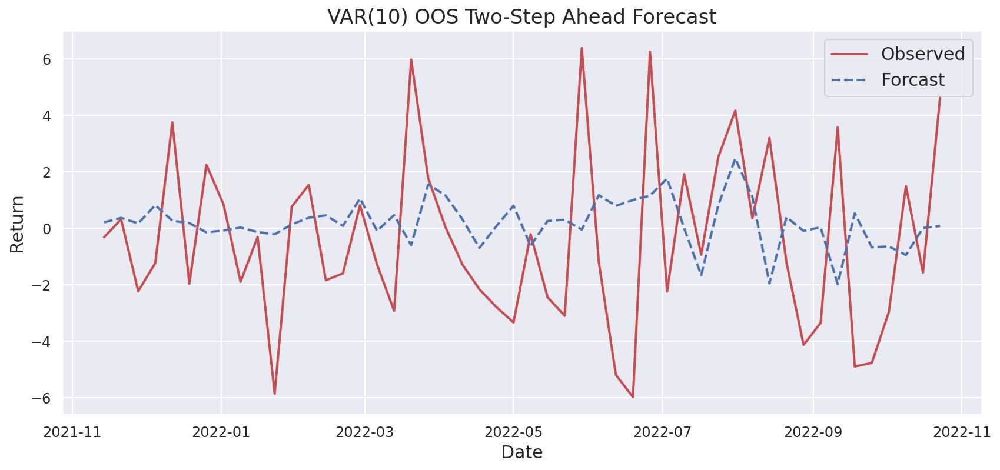

In [ ]:
'''Collecting 2-Step Ahead Forecasts'''

pred_step2 =  [pred['S&P 500 Log Return'][1:2] for pred in preds]
actual_step2 =  [actual['S&P 500 Log Return'][1:2] for actual in actuals]
actual_step2 = pd.concat(actual_step2,ignore_index=False)
pred_step2 = pd.concat(pred_step2,ignore_index=False)
    
plt.figure(figsize=[14,6])
plt.plot(actual_step2,'r',lw=2,label='Observed')
plt.plot(pred_step2,'b--',lw=2,label='Forcast')
plt.legend(fontsize=15)
plt.title(f'VAR({results.k_ar}) OOS Two-Step Ahead Forecast',fontsize=17)
plt.xlabel('Date',fontsize=15)
plt.tick_params(labelsize=12)
plt.ylabel('Return',fontsize=15)

'''Performance Metrics'''
model4_step2_R2 = r2_score(actual_step2, pred_step2)
model4_step2_rmse = mse(actual_step2,pred_step2, squared=False)
model4_step2_mape = mape(actual_step2,pred_step2)

print('R2: ',model4_step2_R2)
print('RMSE: ',model4_step2_rmse)
print('MAPE: ',model4_step2_mape)

R2:  -0.11928202981531633
RMSE:  3.301557317176009
MAPE:  1.2769307486439105


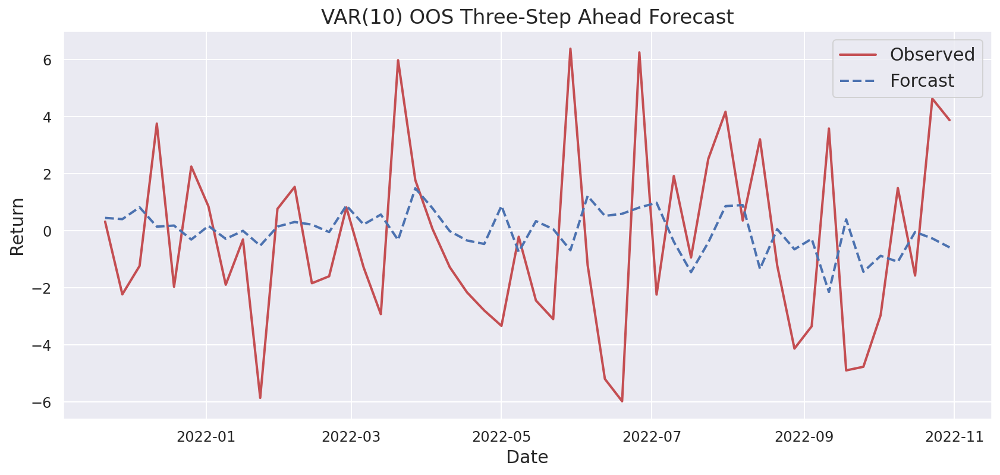

In [ ]:
'''Collecting 3-Step Ahead Forecasts'''

pred_step3 =  [pred['S&P 500 Log Return'][2:] for pred in preds]
actual_step3 =  [actual['S&P 500 Log Return'][2:] for actual in actuals]
actual_step3 = pd.concat(actual_step3,ignore_index=False)
pred_step3 = pd.concat(pred_step3,ignore_index=False)
    
plt.figure(figsize=[14,6])
plt.plot(actual_step3,'r',lw=2,label='Observed')
plt.plot(pred_step3,'b--',lw=2,label='Forcast')
plt.legend(fontsize=15)
plt.title(f'VAR({results.k_ar}) OOS Three-Step Ahead Forecast',fontsize=17)
plt.xlabel('Date',fontsize=15)
plt.tick_params(labelsize=12)
plt.ylabel('Return',fontsize=15)

'''Performance Metrics'''
model4_step3_R2 = r2_score(actual_step3, pred_step3)
model4_step3_rmse = mse(actual_step3,pred_step3, squared=False)
model4_step3_mape = mape(actual_step3,pred_step3)

print('R2: ',model4_step3_R2)
print('RMSE: ',model4_step3_rmse)
print('MAPE: ',model4_step3_mape)

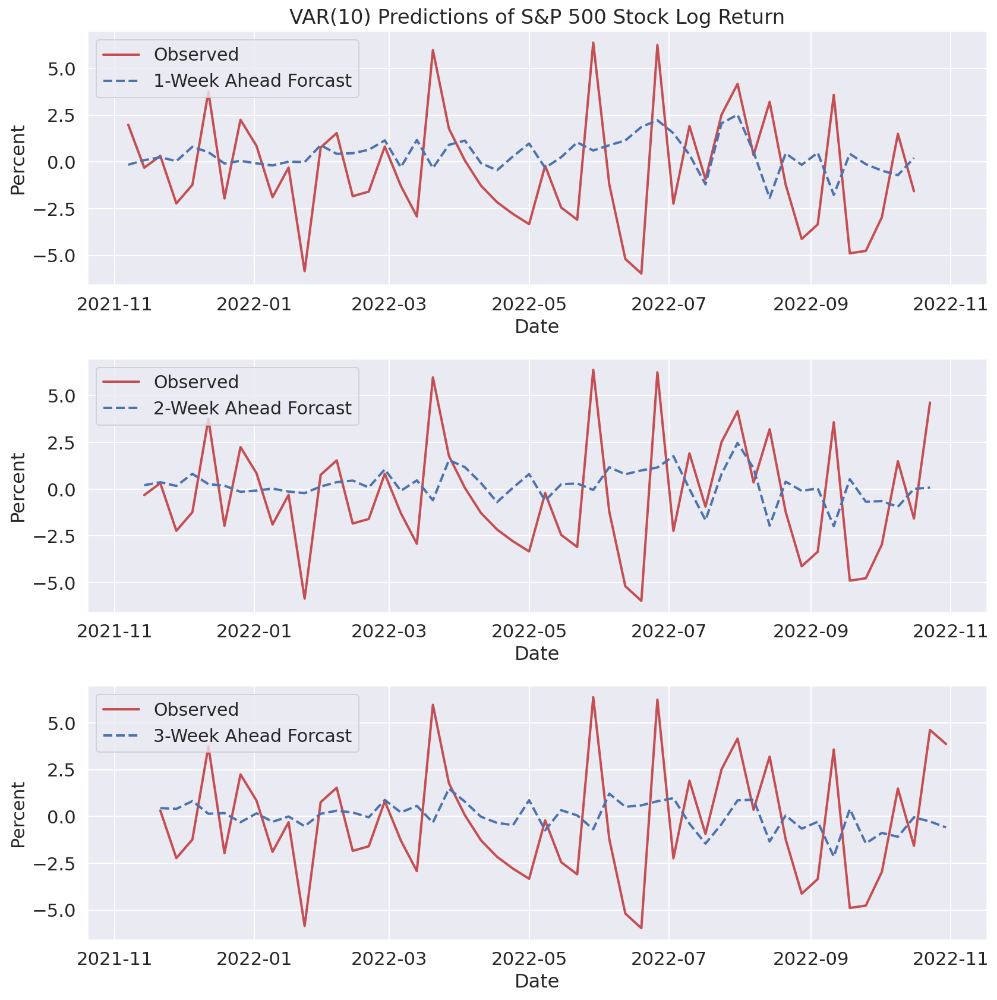

In [ ]:
fig,axes=plt.subplots(nrows=3,ncols=1,figsize=[12,12],sharex=True,sharey=True)

axes[0].plot(actual_step1,'r',lw=2,label='Observed')
axes[0].plot(pred_step1,'b--',lw=2,label='1-Week Ahead Forcast')
axes[0].set_ylabel('Percent',fontsize=16)
axes[0].set_title(f'VAR({results.k_ar}) Predictions of S&P 500 Stock Log Return',fontsize=17)
axes[0].legend(fontsize=15)
axes[0].xaxis.set_tick_params(labelbottom=True)
axes[0].set_xlabel('Date',fontsize=16)

axes[1].plot(actual_step2,'r',lw=2,label='Observed')
axes[1].plot(pred_step2,'b--',lw=2,label='2-Week Ahead Forcast')
axes[1].set_ylabel('Percent',fontsize=16)
axes[1].legend(fontsize=15)
axes[1].xaxis.set_tick_params(labelbottom=True)
axes[1].set_xlabel('Date',fontsize=16)

axes[2].plot(actual_step3,'r',lw=2,label='Observed')
axes[2].plot(pred_step3,'b--',lw=2,label='3-Week Ahead Forcast')
axes[2].set_ylabel('Percent',fontsize=15)
axes[2].legend(fontsize=15)
axes[2].xaxis.set_tick_params(labelbottom=True)
axes[2].set_xlabel('Date',fontsize=16)

plt.tight_layout()

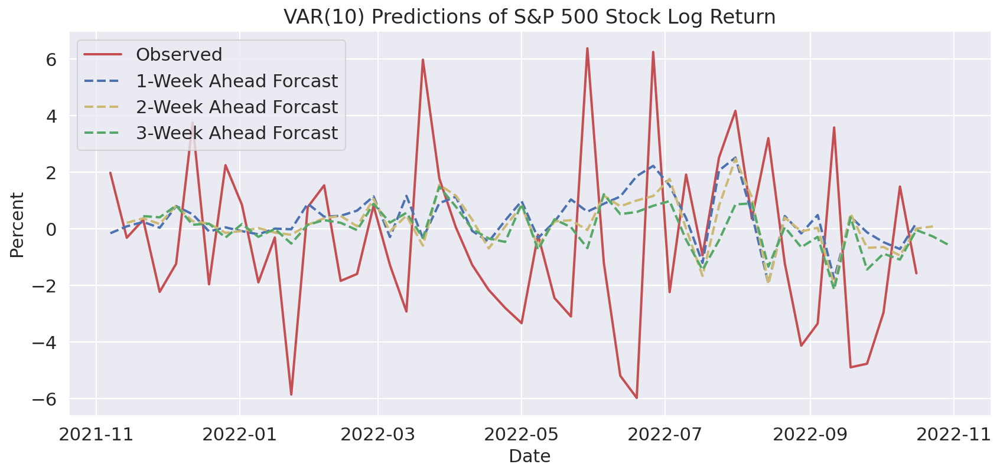

In [ ]:
fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True,sharey=True)

ax.plot(actual_step1,'r',lw=2,label='Observed')

ax.plot(pred_step1,'b--',lw=2,label='1-Week Ahead Forcast')
ax.set_ylabel('Percent',fontsize=15)
ax.set_xlabel('Date',fontsize=15)
ax.set_title(f'VAR({results.k_ar}) Predictions of S&P 500 Stock Log Return',fontsize=17)
ax.legend(fontsize=15)
ax.plot(pred_step2,'y--',lw=2,label='2-Week Ahead Forcast')
ax.plot(pred_step3,'g--',lw=2,label='3-Week Ahead Forcast')
ax.legend()

In [ ]:
'DW for residuals'

DW_results = durbin_watson(results.resid)

for name, value in zip(train.columns, DW_results):
    print(name, ':', round(value, 4))

Crude Oil Futures Log Return : 1.9987
Gold Futures Log Return : 2.0008
S&P 500 Log Return : 1.9881
Change in 3M T-Bill Yield : 1.9899
Change in 10Y-3M Treasury Yield Spread : 1.9986


In [ ]:
'''Store the metrics'''

model4_results = {'rmse':[model4_step1_rmse,model4_step2_rmse,model4_step3_rmse],
          'mape':[model4_step1_mape,model4_step2_mape,model4_step3_mape],
          'R2':[model4_step1_R2,model4_step3_R2,model4_step3_R2]}

models.append(model4_results)

<a id="part11"></a>

## Model 5: Multivariate Long Short Term Memory

[Return to contents](#contents) 

In [ ]:
train, test = estimation_data, test_data

In [ ]:
cols = train.columns
target_col = 'S&P 500 Log Return'


'''Standardization'''

scaler = StandardScaler()
train_scaled = scaler.fit_transform(train)
test_scaled = scaler.transform(test)

In [ ]:
'''Scaled Data'''

full_scaled = np.vstack([train_scaled,test_scaled])
pd.DataFrame(full_scaled,index=df_rtn.index,columns=df_rtn.columns).to_excel('full_data.xlsx')

In [ ]:
'''Function to reverse the standardization transformation'''

def inverse_transform(scaler, series, target_col, col_names):
    dummy_df = pd.DataFrame(np.zeros((len(series), len(col_names))), columns=col_names)
    dummy_df[target_col] = series
    dummy_df = pd.DataFrame(scaler.inverse_transform(dummy_df), columns=col_names)
    return dummy_df[target_col].values

In [ ]:
'''reshape data to fit for model input and output'''

def reshape_data(data,n_lag,n_next,target_col):

    n_features = data.shape[1]
    X, y = [], []
    
    for i in range(data.shape[0]-n_lag-n_next+1):
        X_component = data[i:(i+n_lag),:]
        X.append(X_component)
        y_component = data[(i+n_lag):(i+n_lag+n_next),target_col]
        y.append(y_component)
    X = np.array(X)
    y = np.array(y)
    y = y [:,:,np.newaxis]

    return X,y 

In [ ]:
'''reshape data for model input'''

X,y=reshape_data(full_scaled,52,3,2)

In [ ]:
'''resplit the reshaped data'''

steps = 3
X_train,y_train = X[:-(test_size-steps+1)],y[:-(test_size-steps+1)]
print(X_train.shape)
print(y_train.shape)

(939, 52, 5)
(939, 3, 1)


In [ ]:
'''resplit the reshaped data'''

X_test,y_test = X[-(test_size-steps+1):],y[-(test_size-steps+1):]
print(X_test.shape)
print(y_test.shape)

(50, 52, 5)
(50, 3, 1)


In [ ]:
'''Implement LSTM as a SKlearn estimator'''

from sklearn.base import BaseEstimator

class lstm_model(BaseEstimator):
  def __init__(self,layer1_nodes=32,
               layer2_nodes=64,
               dropout=0.2,
               learning_rate=0.001,
               batch_size=32,
               l1=0,
               l2=0.001,
               recurrent_activation = 'relu',
               activation='linear',
               epochs=1500):
    
    self.layer1_nodes=layer1_nodes
    self.layer2_nodes = layer2_nodes
    self.dropout= dropout
    self.learning_rate = learning_rate
    self.batch_size = batch_size
    self.l1 = l1
    self.l2 = l2
    self.recurrent_activation = recurrent_activation
    self.activation=activation
    self.epochs = epochs
    self.simple_lstm_model = Sequential()


  def score(self,X,y):
    pred = self.simple_lstm_model.predict(X)
    pred1 = pred[:,0] #based on 1-step ahead mse
    pred2 = pred[:,1]
    pred3 = pred[:,2]
    y1 = y[:,0,0]
    y2 = y[:,1,0]
    y3 = y[:,2,0]
    return mse(pred1,y1)+mse(pred2,y2)+mse(pred3,y3)

  def fit(self,X_train,y_train):
    nodes = [self.layer1_nodes,self.layer2_nodes]
    recurrent_activation = self.recurrent_activation
    activation = self.activation
    batch_size = self.batch_size
    learning_rate = self.learning_rate
    dropout = self.dropout
    l1 = self.l1
    l2 = self.l2
    epochs = self.epochs

    if nodes[1] == 0:
        self.simple_lstm_model.add(LSTM(nodes[0],
                                        input_shape=(X_train.shape[1],X_train.shape[2]), 
                                        activation=recurrent_activation, 
                                        kernel_regularizer=L1L2(l1, l2),
                                        return_sequences=False))
        self.simple_lstm_model.add(Dropout(dropout))
    else:
        self.simple_lstm_model.add(LSTM(nodes[0],
                                        input_shape=(X_train.shape[1], X_train.shape[2]), 
                                        activation=recurrent_activation,
                                        kernel_regularizer=L1L2(l1, l2),
                                        return_sequences=True))
        
        self.simple_lstm_model.add(Dropout(dropout))
        self.simple_lstm_model.add(LSTM(nodes[1],
                                        activation=recurrent_activation,
                                        kernel_regularizer=L1L2(l1, l2), 
                                        return_sequences=False))
        self.simple_lstm_model.add(Dropout(dropout))

    self.simple_lstm_model.add(Dense(y_train.shape[1],activation=activation))
    opt = tf.keras.optimizers.Adam(learning_rate=learning_rate)
    self.simple_lstm_model.compile(loss='mse', optimizer=opt)
    early_stopping = EarlyStopping(monitor='val_loss', patience = 5, restore_best_weights=True)
    self.simple_lstm_model.fit(X_train,y_train,
                      batch_size=batch_size,
                      validation_split = 0.1,
                      epochs=epochs,
                      callbacks=[early_stopping])
    return self

  def _get_params(self,deep=False):
    params = {'layer1_nodes':self.layer1_nodes,
                   'layer2_nodes':self.layer2_nodes,
                   'dropout':self.dropout,
                   'learning_rate':self.learning_rate,
                   'batch_size':self.batch_size,
                   'l1':self.l1,
                   'l2':self.l2,
                   'epochs':self.epochs,
                   'recurrent_activation':self.recurrent_activation,
                   'activation':self.activation
                   }
    return params

  def _set_params(self,deep=False,**kwargs):
    for key,val in kwargs.items():
      self.key = val
    return self.params
  
  def predict(self,X):
    return self.simple_lstm_model.predict(X)


In [ ]:
'''This function is modified from examples given by scikit-learn
https://scikit-learn.org/stable/auto_examples/model_selection/plot_cv_indices.html'''

def plot_cv_indices(cv, X, y, ax, n_splits, lw=10):
    """Create a sample plot for indices of a cross-validation object."""

    # Generate the training/testing visualizations for each CV split
    for i,(tr, tt) in enumerate(cv.split(X=X, y=y)):
        # Fill in indices with the training/test groups
        indices = np.array([np.nan] * len(X))
        indices[tt] = 1
        indices[tr] = 0

        # Visualize the results
        ax.scatter(
            range(len(indices)),
            [i + 0.5] * len(indices),
            c=indices,
            marker="_",
            lw=lw,
            vmin=-0.2,
            vmax=1.2,
        )
        # Formatting
        yticklabels = list(range(1,n_splits+1))
        ax.set(
          yticks=np.arange(n_splits + 2) + 0.5,
          yticklabels=yticklabels,
          xlabel="Sample index",
          ylabel="CV iteration",
          ylim=[n_splits +0.5, -0.2],
          xlim=[0, len(X)],
        )
        
    ax.set_title(f"Expanding Window {n_splits}-Split Time Series Cross Validation", fontsize=15)
    return ax

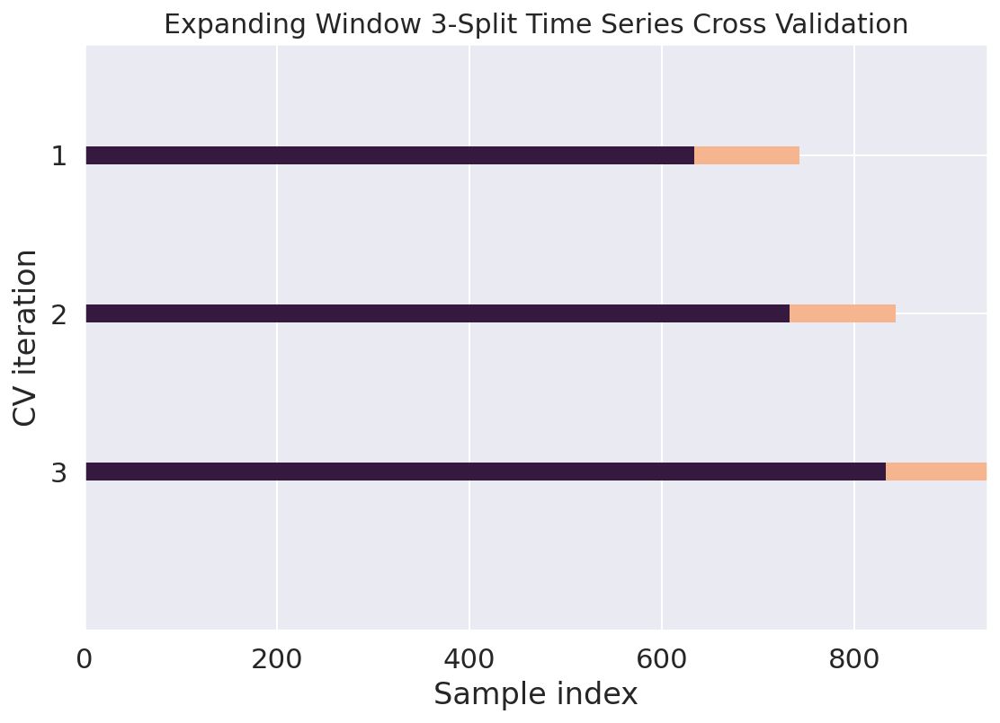

In [ ]:
'''Expanding window cross validation'''

from sklearn.model_selection import TimeSeriesSplit

tscv = TimeSeriesSplit(n_splits = 3, test_size=100)

fig, ax = plt.subplots(figsize = [9,6])

plot_cv_indices(tscv, X_train, y_train, ax=ax, n_splits=3)
plt.show()

In [ ]:
'''Doing grid Search'''

from sklearn.model_selection import GridSearchCV

parameters = {'layer1_nodes':[16,32,64,128],'layer2_nodes':[0,16,32,64,128],'batch_size':[32,64],'learning_rate':[0.01,0.001,0.0001],'drop_out':[0.1,0.2,0.3]}

lstm = lstm_model()
clf = GridSearchCV(lstm, parameters,cv=tscv)

In [ ]:
'''for tuning only, will take a long time to run'''

# clf.fit(X_train, y_train)
# clf.best_estimator_.get_params()
# clf.cv_results_

In [ ]:
'''set seed'''

from numpy.random import seed
seed(0)

In [ ]:
'''fit the best model we found'''

def lstm_model (X_train, y_train,nodes=[16,16],val_ratio =0.1, dropout=0.1,bs=16,epochs=1200,reg=L1L2(l1=0, l2=0.001), lr = 0.0001, recurrent_activation = 'relu',early_stopping = False):
    
    if len(nodes)==1:
        simple_lstm_model = Sequential()
        simple_lstm_model.add(LSTM(nodes[0],input_shape=(X_train.shape[1], X_train.shape[2]), activation=recurrent_activation, kernel_regularizer=reg,return_sequences=False))
        simple_lstm_model.add(Dropout(dropout))
    elif len(nodes)==2:
        simple_lstm_model = Sequential()
        simple_lstm_model.add(LSTM(nodes[0],input_shape=(X_train.shape[1], X_train.shape[2]), activation=recurrent_activation,kernel_regularizer=reg,return_sequences=True))
        simple_lstm_model.add(Dropout(dropout))

        simple_lstm_model.add(LSTM(nodes[1],activation=recurrent_activation,kernel_regularizer=reg, return_sequences=False))
        simple_lstm_model.add(Dropout(dropout))
        

    simple_lstm_model.add(Dense(y_train.shape[1]))

    opt = tf.keras.optimizers.Adam(learning_rate=lr)

    simple_lstm_model.compile(loss='mse', optimizer=opt)
    if early_stopping:
      early_stopping = [EarlyStopping(monitor='val_loss', patience = 5, restore_best_weights=True)]
    else:
      early_stopping = []

    history=simple_lstm_model.fit(X_train,y_train,
                      epochs=epochs,
                      batch_size=bs,
                      validation_split = val_ratio,verbose=1,
                      callbacks=early_stopping)
    return simple_lstm_model,history.history

In [ ]:
model,history=lstm_model(X_train,y_train,val_ratio = 0,nodes=[64],epochs=25,bs=32,lr=0.001,dropout=0.2,early_stopping=False)

Epoch 1/25
30/30 [==============================] - 5s 76ms/step - loss: 1.0351
Epoch 2/25
30/30 [==============================] - 2s 75ms/step - loss: 1.0246
Epoch 3/25
30/30 [==============================] - 2s 76ms/step - loss: 1.0091
Epoch 4/25
30/30 [==============================] - 2s 71ms/step - loss: 0.9890
Epoch 5/25
30/30 [==============================] - 2s 69ms/step - loss: 0.9891
Epoch 6/25
30/30 [==============================] - 2s 69ms/step - loss: 0.9695
Epoch 7/25
30/30 [==============================] - 2s 71ms/step - loss: 0.9735
Epoch 8/25
30/30 [==============================] - 2s 69ms/step - loss: 0.9550
Epoch 9/25
30/30 [==============================] - 2s 68ms/step - loss: 0.9593
Epoch 10/25
30/30 [==============================] - 2s 71ms/step - loss: 0.9360
Epoch 11/25
30/30 [==============================] - 2s 72ms/step - loss: 0.9209
Epoch 12/25
30/30 [==============================] - 2s 83ms/step - loss: 0.9050
Epoch 13/25
30/30 [==================

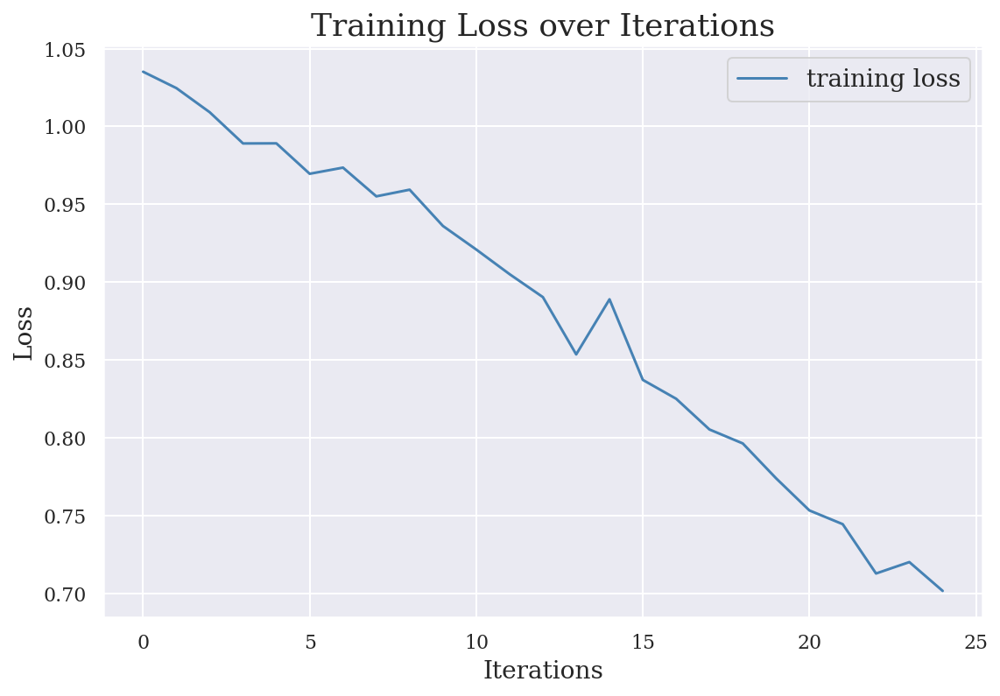

In [ ]:
plt.figure(figsize=[9,6])
plt.plot(history['loss'],label='training loss')
plt.xlabel('Iterations',fontsize=14)
plt.ylabel('Loss',fontsize=14)
plt.title('Training Loss over Iterations',fontsize=18)
plt.legend(fontsize=14)

1/1 [==============================] - 0s 21ms/step


<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)
<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)
<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warnin

1/1 [==============================] - 0s 20ms/step


<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)
<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)
<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warnin

1/1 [==============================] - 0s 19ms/step


<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)
<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)
<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warnin

1/1 [==============================] - 0s 21ms/step


<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)
<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)
<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warnin

1/1 [==============================] - 0s 19ms/step


<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)
<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)
<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warnin

1/1 [==============================] - 0s 19ms/step


<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)
<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)
<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warnin

1/1 [==============================] - 0s 21ms/step


<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)
<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)


1/1 [==============================] - 0s 23ms/step


<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)
<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)
<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warnin

1/1 [==============================] - 0s 21ms/step


<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)
<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)
<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warnin

1/1 [==============================] - 0s 26ms/step


<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)
<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)
<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warnin

1/1 [==============================] - 0s 22ms/step


<ipython-input-55-aca0c7bdcd56>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)


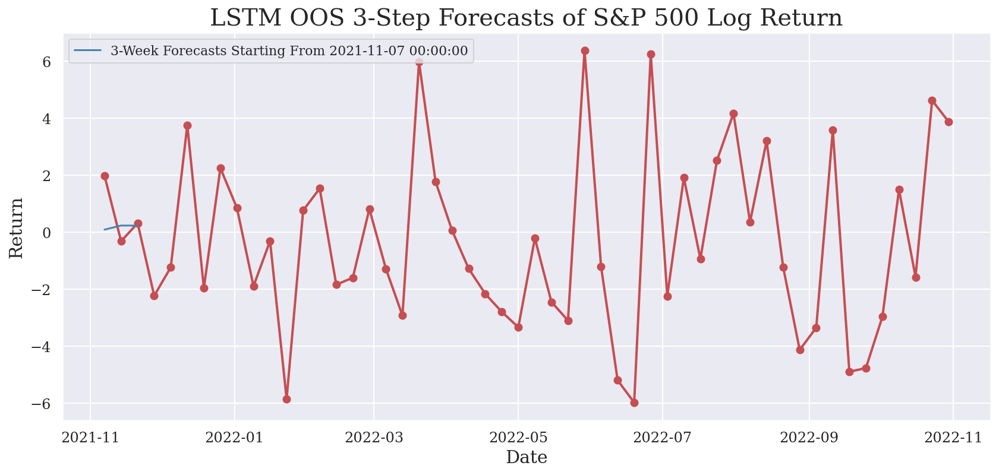

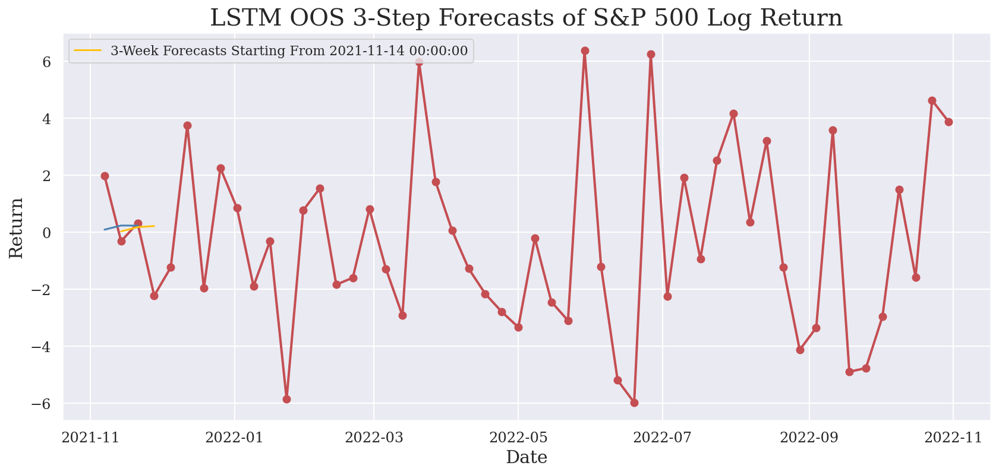

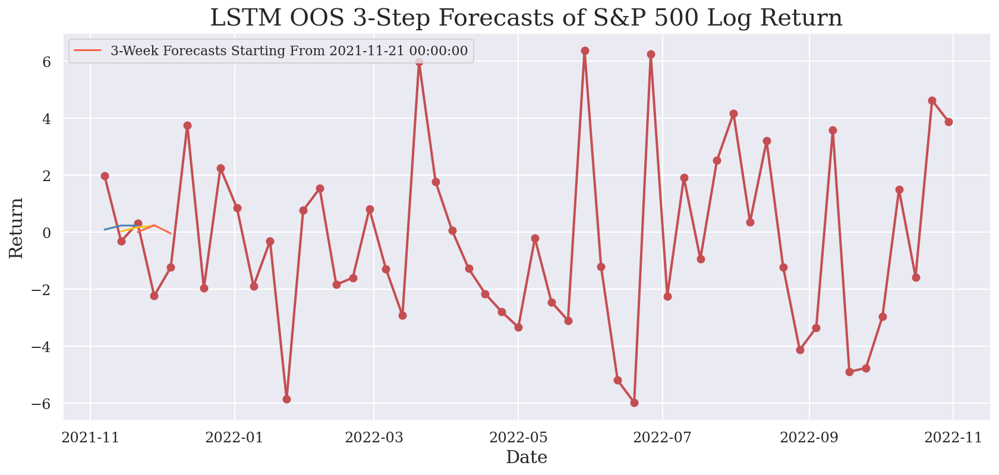

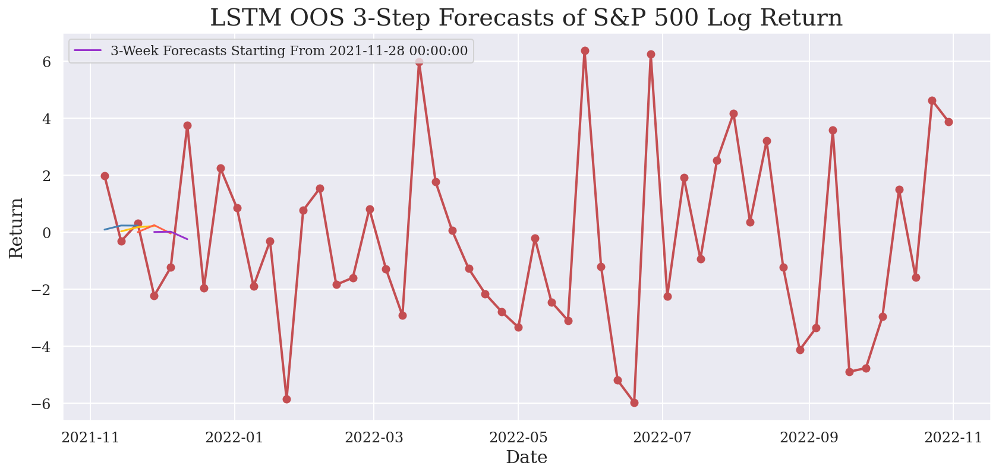

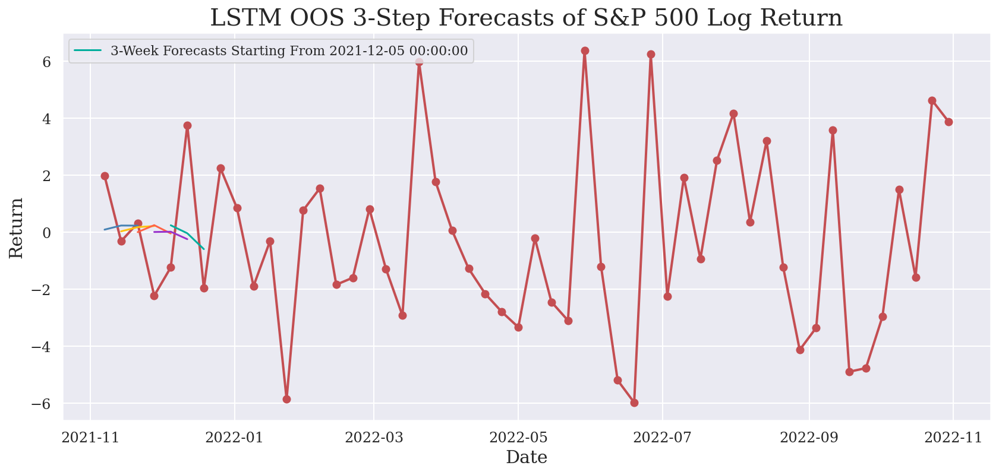

...

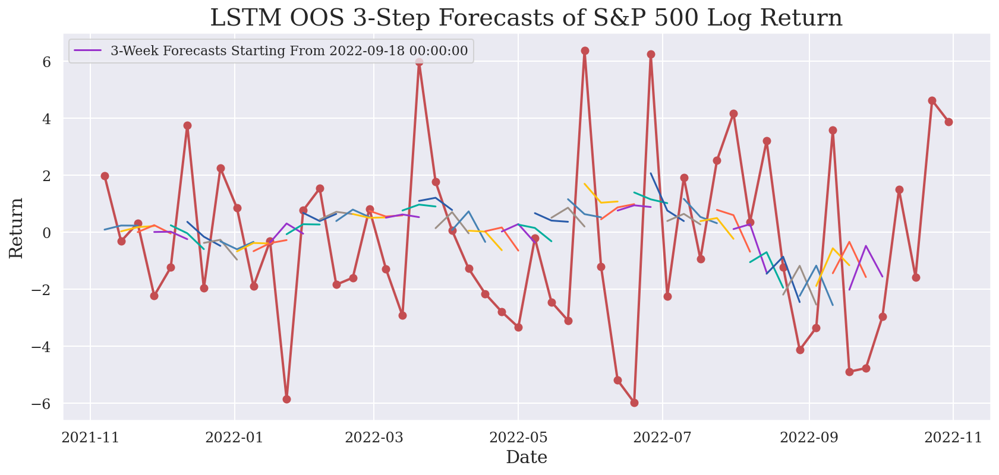

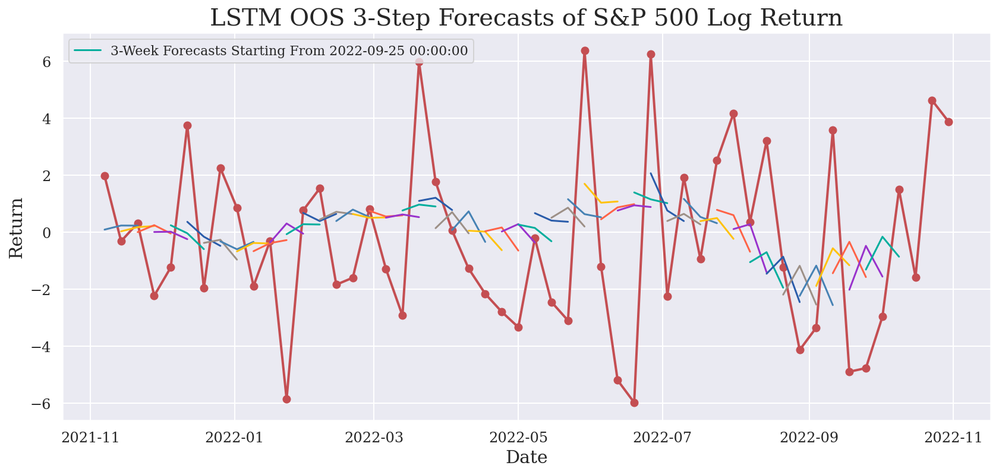

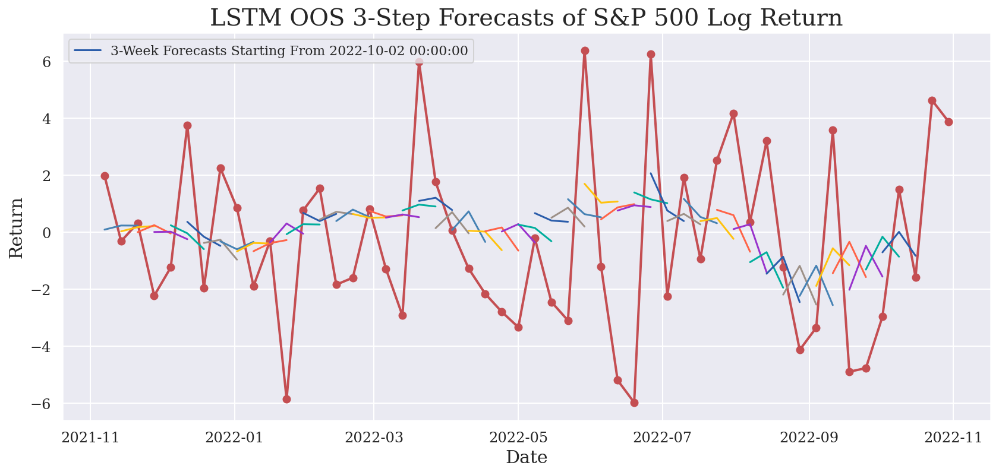

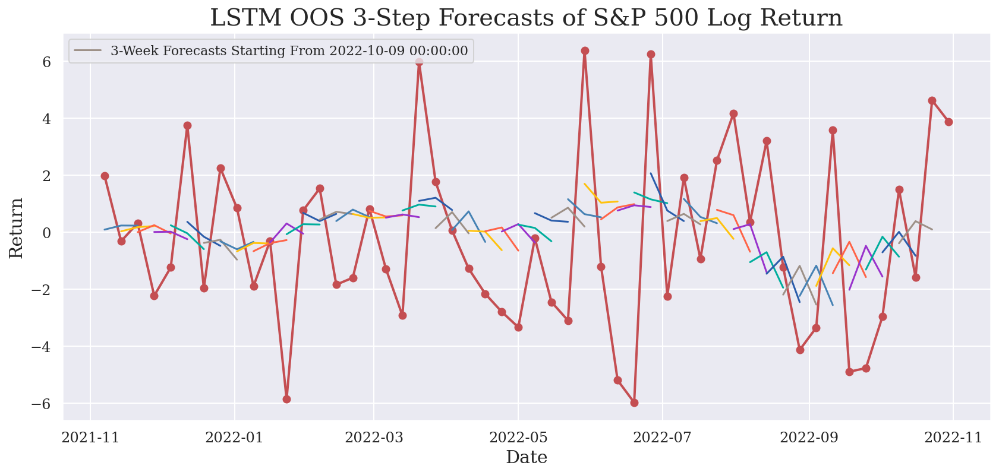

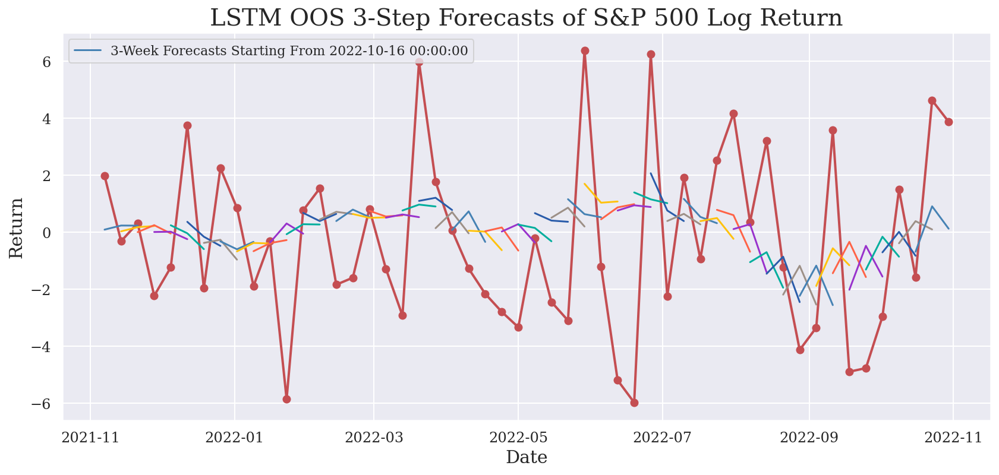

In [ ]:
'''get some previews'''

'''for gif only'''
# import time
# time.sleep(5)

# preds=[]
# actuals=[]
# steps = 3
# for i in range(X_test.shape[0]):

#     # Input data for forecasting
#     offset = X_test[i,:,:]
#     pred = model.predict(offset.reshape(1,-1,5))
#     pred = inverse_transform(scaler, pred.reshape(-1), target_col=target_col, col_names=test.columns)
#     pred = pd.Series(pred,index=test.index[i:i+steps],name=target_col)
#     preds.append(pred)
    
#     actual=pd.Series(inverse_transform(scaler, y_test[i].reshape(-1), target_col=target_col, col_names=cols),index=test.index[i:i+steps],name=target_col)
#     actuals.append(actual)

#     fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)
#     ax.plot(test['S&P 500 Log Return'],'r-o',lw=2)

#     for pred in preds[:-1]:
#       ax.plot(pred)
#     ax.plot(preds[-1],label= f'3-Week Forecasts Starting From {preds[-1].index[0]}')

#     ax.set_title('LSTM OOS 3-Step Forecasts of '+target_col,fontsize=20)
#     ax.set_xlabel('Date',fontsize=15)
#     ax.set_ylabel('Return',fontsize=15)
#     ax.legend(['Observed '+target_col],fontsize=15)
#     ax.tick_params(labelsize=12)
#     ax.legend()

1/1 [==============================] - 0s 20ms/step


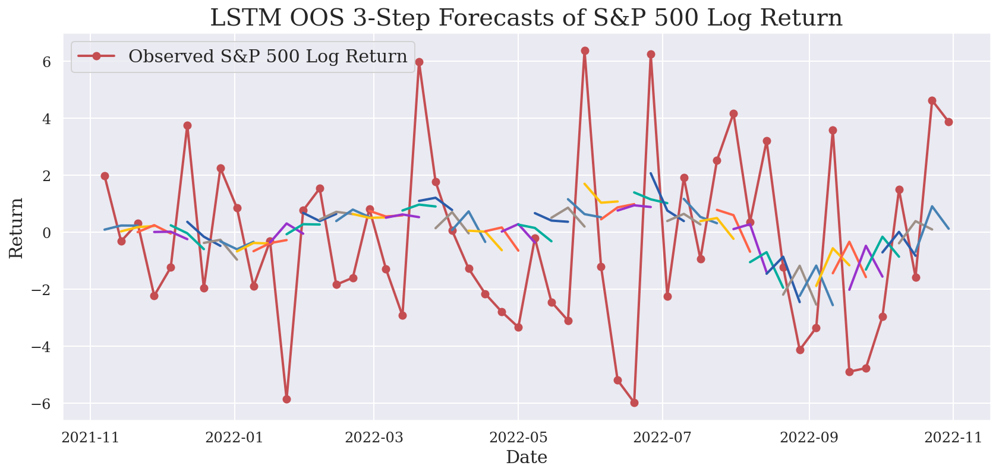

In [ ]:
'''out-of Sample 3-step forecast for SP500'''

preds=[]
actuals=[]
steps = 3
for i in range(X_test.shape[0]):

    # Input data for forecasting
    offset = X_test[i,:,:]
    pred = model.predict(offset.reshape(1,-1,5))
    pred = inverse_transform(scaler, pred.reshape(-1), target_col=target_col, col_names=test.columns)
    pred = pd.Series(pred,index=test.index[i:i+steps],name=target_col)
    preds.append(pred)
    
    actual=pd.Series(inverse_transform(scaler, y_test[i].reshape(-1), target_col=target_col, col_names=cols),index=test.index[i:i+steps],name=target_col)
    actuals.append(actual)

fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True)
ax.plot(test['S&P 500 Log Return'],'r-o',lw=2)

for pred in preds:
  ax.plot(pred,lw=2)
ax.set_title('LSTM OOS 3-Step Forecasts of '+target_col,fontsize=20)
ax.set_xlabel('Date',fontsize=15)
ax.set_ylabel('Return',fontsize=15)
ax.legend(['Observed '+target_col],fontsize=15)
ax.tick_params(labelsize=12)

R2:  0.055646071612326375
RMSE:  2.910784283730495
MAPE:  1.060715714135572


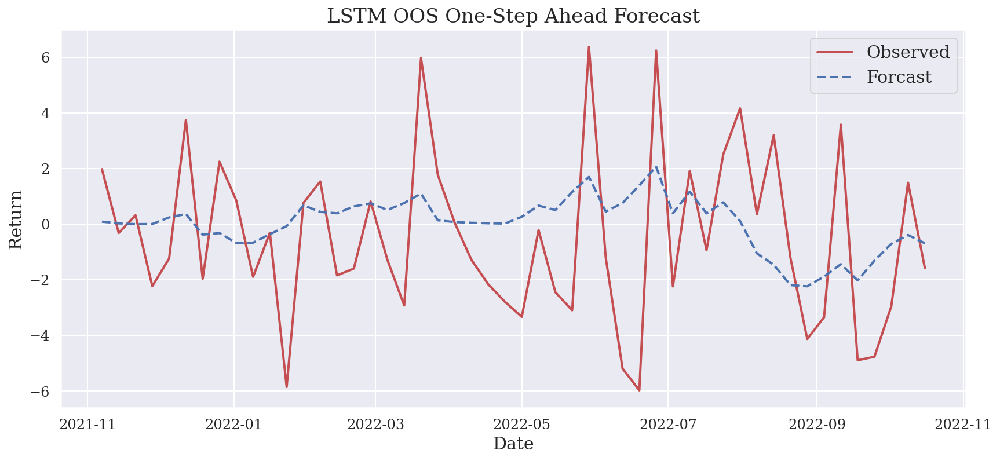

In [ ]:
'''Collecting 1-Step Ahead Forecasts'''

pred_step1 =  [pred[0:1] for pred in preds]
actual_step1 =  [actual[0:1] for actual in actuals]
actual_step1 = pd.concat(actual_step1,ignore_index=False)
pred_step1 = pd.concat(pred_step1,ignore_index=False)
    
plt.figure(figsize=[14,6])
plt.plot(actual_step1,'r',lw=2,label='Observed')
plt.plot(pred_step1,'b--',lw=2,label='Forcast')
plt.legend(fontsize=15)
plt.title(f'LSTM OOS One-Step Ahead Forecast',fontsize=17)
plt.xlabel('Date',fontsize=15)
plt.tick_params(labelsize=12)
plt.ylabel('Return',fontsize=15)

'''Performance Metrics'''
model5_step1_R2 = r2_score(actual_step1, pred_step1)
model5_step1_rmse = mse(actual_step1,pred_step1, squared=False)
model5_step1_mape = mape(actual_step1,pred_step1)

print('R2: ',model5_step1_R2)
print('RMSE: ',model5_step1_rmse)
print('MAPE: ',model5_step1_mape)

R2:  -0.013819877187320584
RMSE:  3.0824382071568635
MAPE:  1.2045918400642694


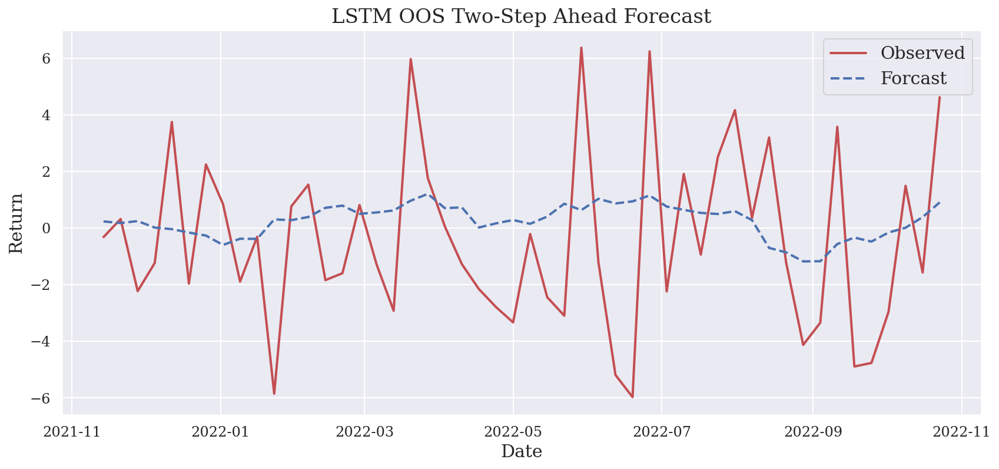

In [ ]:
'''Collecting 2-Step Ahead Forecasts'''

pred_step2 =  [pred[1:2] for pred in preds]
actual_step2 =  [actual[1:2] for actual in actuals]
actual_step2 = pd.concat(actual_step2,ignore_index=False)
pred_step2 = pd.concat(pred_step2,ignore_index=False)
    
plt.figure(figsize=[14,6])
plt.plot(actual_step2,'r',lw=2,label='Observed')
plt.plot(pred_step2,'b--',lw=2,label='Forcast')
plt.legend(fontsize=15)
plt.title(f'LSTM OOS Two-Step Ahead Forecast',fontsize=17)
plt.xlabel('Date',fontsize=15)
plt.tick_params(labelsize=12)
plt.ylabel('Return',fontsize=15)

'''Performance Metrics'''
model5_step2_R2 = r2_score(actual_step2, pred_step2)
model5_step2_rmse = mse(actual_step2,pred_step2, squared=False)
model5_step2_mape = mape(actual_step2,pred_step2)

print('R2: ',model5_step2_R2)
print('RMSE: ',model5_step2_rmse)
print('MAPE: ',model5_step2_mape)

R2:  -0.005020867712268284
RMSE:  3.1285032852972434
MAPE:  1.2122410399774826


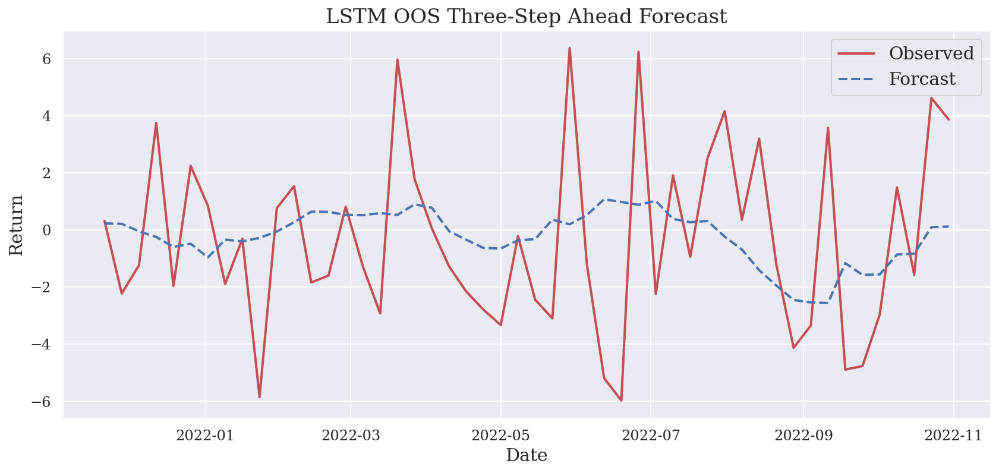

In [ ]:
'''Collecting 3-Step Ahead Forecasts'''

pred_step3 =  [pred[2:] for pred in preds]
actual_step3 =  [actual[2:] for actual in actuals]
actual_step3 = pd.concat(actual_step3,ignore_index=False)
pred_step3 = pd.concat(pred_step3,ignore_index=False)
    
plt.figure(figsize=[14,6])
plt.plot(actual_step3,'r',lw=2,label='Observed')
plt.plot(pred_step3,'b--',lw=2,label='Forcast')
plt.legend(fontsize=15)
plt.title(f'LSTM OOS Three-Step Ahead Forecast',fontsize=17)
plt.xlabel('Date',fontsize=15)
plt.tick_params(labelsize=12)
plt.ylabel('Return',fontsize=15)

'''Performance Metrics'''
model5_step3_R2 = r2_score(actual_step3, pred_step3)
model5_step3_rmse = mse(actual_step3,pred_step3, squared=False)
model5_step3_mape = mape(actual_step3,pred_step3)

print('R2: ',model5_step3_R2)
print('RMSE: ',model5_step3_rmse)
print('MAPE: ',model5_step3_mape)

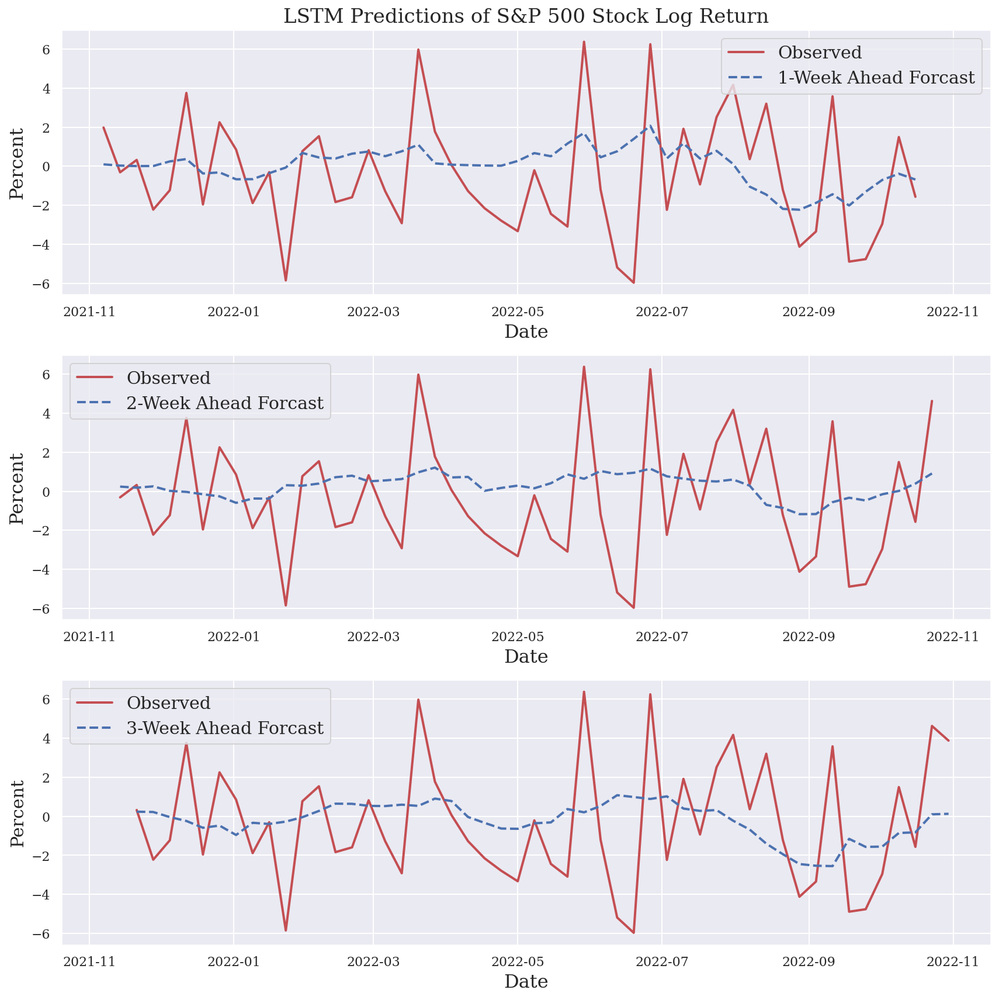

In [ ]:
fig,axes=plt.subplots(nrows=3,ncols=1,figsize=[12,12],sharex=True,sharey=True)

axes[0].plot(actual_step1,'r',lw=2,label='Observed')
axes[0].plot(pred_step1,'b--',lw=2,label='1-Week Ahead Forcast')
axes[0].set_ylabel('Percent',fontsize=16)
axes[0].set_title(f'LSTM Predictions of S&P 500 Stock Log Return',fontsize=17)
axes[0].legend(fontsize=15)
axes[0].xaxis.set_tick_params(labelbottom=True)
axes[0].set_xlabel('Date',fontsize=16)

axes[1].plot(actual_step2,'r',lw=2,label='Observed')
axes[1].plot(pred_step2,'b--',lw=2,label='2-Week Ahead Forcast')
axes[1].set_ylabel('Percent',fontsize=16)
axes[1].legend(fontsize=15)
axes[1].xaxis.set_tick_params(labelbottom=True)
axes[1].set_xlabel('Date',fontsize=16)

axes[2].plot(actual_step3,'r',lw=2,label='Observed')
axes[2].plot(pred_step3,'b--',lw=2,label='3-Week Ahead Forcast')
axes[2].set_ylabel('Percent',fontsize=15)
axes[2].legend(fontsize=15)
axes[2].xaxis.set_tick_params(labelbottom=True)
axes[2].set_xlabel('Date',fontsize=16)

plt.tight_layout()

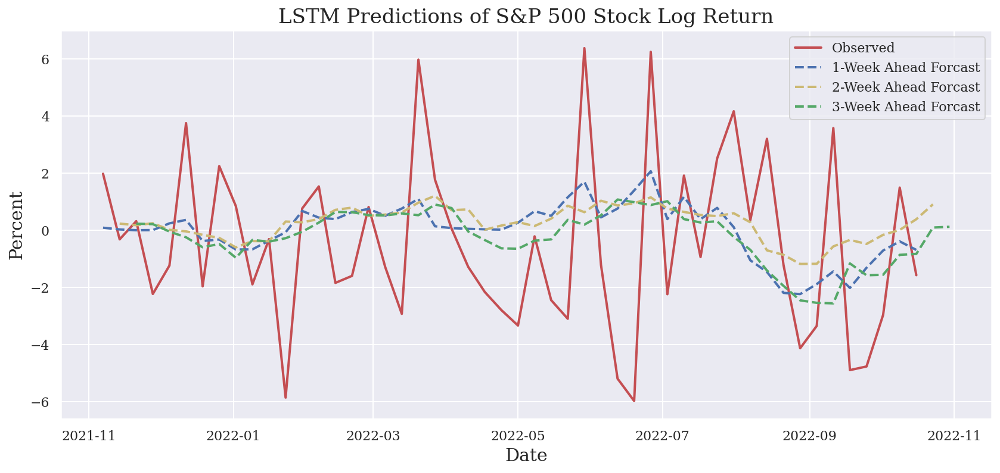

In [ ]:
fig,ax=plt.subplots(nrows=1,ncols=1,figsize=[14,6],sharex=True,sharey=True)

ax.plot(actual_step1,'r',lw=2,label='Observed')

ax.plot(pred_step1,'b--',lw=2,label='1-Week Ahead Forcast')
ax.set_ylabel('Percent',fontsize=15)
ax.set_xlabel('Date',fontsize=15)
ax.set_title(f'LSTM Predictions of S&P 500 Stock Log Return',fontsize=17)
ax.legend(fontsize=15)
ax.plot(pred_step2,'y--',lw=2,label='2-Week Ahead Forcast')
ax.plot(pred_step3,'g--',lw=2,label='3-Week Ahead Forcast')
ax.legend()